<a href="https://colab.research.google.com/github/BenLiu983/Store_Sales_Prediction_with_Time_Series/blob/main/EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# BASE
# ------------------------------------------------------
import numpy as np
import pandas as pd
import os
import gc
import warnings

# PACF - ACF
# ------------------------------------------------------
import statsmodels.api as sm

# DATA VISUALIZATION
# ------------------------------------------------------
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px


# CONFIGURATIONS
# ------------------------------------------------------
pd.set_option('display.max_columns', None)
pd.options.display.float_format = '{:.2f}'.format
warnings.filterwarnings('ignore')

In [2]:
import plotly.graph_objects as go
fig = go.Figure( go.Scatter(x=[1,2,3], y=[1,3,2] ) )
fig.show()

## 1. Import Data

In [3]:
train = pd.read_csv('/content/drive/MyDrive/DS Projects/Time Series Kaggle/data/train.csv')
test = pd.read_csv('/content/drive/MyDrive/DS Projects/Time Series Kaggle/data/test.csv')
stores = pd.read_csv('/content/drive/MyDrive/DS Projects/Time Series Kaggle/data/stores.csv')
transactions = pd.read_csv('/content/drive/MyDrive/DS Projects/Time Series Kaggle/data/transactions.csv')
transactions = transactions.sort_values(['store_nbr', 'date'])

In [4]:
#holi = pd.read_csv('/content/drive/MyDrive/DS Projects/Time Series Kaggle/data/holidays_events.csv')
#oil = pd.read_csv('/content/drive/MyDrive/DS Projects/Time Series Kaggle/data/oil.csv')

In [5]:
train.head()

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.00,0
1,1,2013-01-01,1,BABY CARE,0.00,0
2,2,2013-01-01,1,BEAUTY,0.00,0
3,3,2013-01-01,1,BEVERAGES,0.00,0
4,4,2013-01-01,1,BOOKS,0.00,0


In [6]:
type(train['date'][0])

str

In [7]:
# Datetime
train['date'] = pd.to_datetime(train.date)

In [8]:
type(train['date'][0])

pandas._libs.tslibs.timestamps.Timestamp

In [9]:
test['date'] = pd.to_datetime(test.date)
transactions['date'] = pd.to_datetime(transactions.date)

In [10]:
train.onpromotion

0            0
1            0
2            0
3            0
4            0
          ... 
3000883      0
3000884      1
3000885    148
3000886      8
3000887      0
Name: onpromotion, Length: 3000888, dtype: int64

In [11]:
# data types
train.onpromotion = train.onpromotion.astype('float16')
train.sales = train.sales.astype('float32')
stores.cluster = stores.cluster.astype('int8')
train.head()

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.00,0.00
1,1,2013-01-01,1,BABY CARE,0.00,0.00
2,2,2013-01-01,1,BEAUTY,0.00,0.00
3,3,2013-01-01,1,BEVERAGES,0.00,0.00
4,4,2013-01-01,1,BOOKS,0.00,0.00


## 2. Transactions

In [12]:
transactions.head(10)

,date,store_nbr,transactions
1,2013-01-02,1,2111
47,2013-01-03,1,1833
93,2013-01-04,1,1863
139,2013-01-05,1,1509
185,2013-01-06,1,520
231,2013-01-07,1,1807
277,2013-01-08,1,1869
323,2013-01-09,1,1910
369,2013-01-10,1,1679
415,2013-01-11,1,1813


In [13]:
# aggregate
train_agg = train.groupby(['date', 'store_nbr']).sales.sum().reset_index()
train_agg.head()

,date,store_nbr,sales
0,2013-01-01,1,0.00
1,2013-01-01,2,0.00
2,2013-01-01,3,0.00
3,2013-01-01,4,0.00
4,2013-01-01,5,0.00


In [14]:
temp = pd.merge(train_agg, transactions, how = 'left')
temp.head()

,date,store_nbr,sales,transactions
0,2013-01-01,1,0.00,NaN
1,2013-01-01,2,0.00,NaN
2,2013-01-01,3,0.00,NaN
3,2013-01-01,4,0.00,NaN
4,2013-01-01,5,0.00,NaN


In [15]:
print("Spearman Correlation between Total Sales and Transactions: {:,.4f}".format(temp.corr('spearman').sales.loc['transactions']))

Spearman Correlation between Total Sales and Transactions: 0.8175


In [16]:
px.line(transactions.sort_values(['store_nbr', 'date']), x='date', y='transactions', color='store_nbr', title='Transactions')

In [17]:
a = transactions.copy()
a['year'] = a.date.dt.year
a['month'] = a.date.dt.month
px.box(a, x = 'year', y = 'transactions', 
       color = 'month', title = "Transactions")

In [18]:
a = transactions.set_index('date').resample("M").transactions.mean().reset_index()
a['year'] = a.date.dt.year
px.line(a, x='date', y='transactions', color='year', title='Monthly Average Transactions')

In [19]:
px.scatter(temp, x='transactions', y='sales', 
           trendline='ols', trendline_color_override='red')

In [20]:
# day of the week
a = transactions.copy()
a['year'] = a.date.dt.year
a['dayofweek'] = a.date.dt.dayofweek+1
a.head()

,date,store_nbr,transactions,year,dayofweek
1,2013-01-02,1,2111,2013,3
47,2013-01-03,1,1833,2013,4
93,2013-01-04,1,1863,2013,5
139,2013-01-05,1,1509,2013,6
185,2013-01-06,1,520,2013,7


In [21]:
a = a.groupby(['year', 'dayofweek']).transactions.mean().reset_index()
a

,year,dayofweek,transactions
0,2013,1,1681.43
1,2013,2,1630.49
2,2013,3,1627.74
3,2013,4,1565.65
4,2013,5,1650.34
5,2013,6,2001.20
6,2013,7,1891.64
7,2014,1,1703.06
8,2014,2,1659.32
9,2014,3,1690.75


In [22]:
px.line(a, x='dayofweek', y='transactions',
        color='year', title='Transactions')

###  Ecuador is an oil-dependent country. Changing oil prices in Ecuador will cause a variance in the model.


In [23]:
# import
oil = pd.read_csv("/content/drive/MyDrive/DS Projects/Time Series Kaggle/data/oil.csv")

In [24]:
oil.head()

,date,dcoilwtico
0,2013-01-01,NaN
1,2013-01-02,93.14
2,2013-01-03,92.97
3,2013-01-04,93.12
4,2013-01-07,93.20


In [25]:
oil['date'] = pd.to_datetime(oil.date)

In [26]:
# resample
oil = oil.set_index('date').dcoilwtico.resample("D").sum().reset_index()

In [27]:
oil

,date,dcoilwtico
0,2013-01-01,0.00
1,2013-01-02,93.14
2,2013-01-03,92.97
3,2013-01-04,93.12
4,2013-01-05,0.00
...,...,...
1699,2017-08-27,0.00
1700,2017-08-28,46.40
1701,2017-08-29,46.46
1702,2017-08-30,45.96


In [28]:
# interpolate
oil['dcoilwtico'] = np.where(oil['dcoilwtico'] == 0, np.nan, oil['dcoilwtico'])
oil['dcoilwtico_interpolated'] = oil.dcoilwtico.interpolate()
oil.head()

,date,dcoilwtico,dcoilwtico_interpolated
0,2013-01-01,NaN,NaN
1,2013-01-02,93.14,93.14
2,2013-01-03,92.97,92.97
3,2013-01-04,93.12,93.12
4,2013-01-05,NaN,93.15


In [29]:
p = oil.melt(id_vars=['date']+list(oil.keys()[5:]), var_name='Legend')
p

,date,Legend,value
0,2013-01-01,dcoilwtico,NaN
1,2013-01-02,dcoilwtico,93.14
2,2013-01-03,dcoilwtico,92.97
3,2013-01-04,dcoilwtico,93.12
4,2013-01-05,dcoilwtico,NaN
...,...,...,...
3403,2017-08-27,dcoilwtico_interpolated,46.82
3404,2017-08-28,dcoilwtico_interpolated,46.40
3405,2017-08-29,dcoilwtico_interpolated,46.46
3406,2017-08-30,dcoilwtico_interpolated,45.96


In [30]:
px.line(p.sort_values(['Legend', 'date'], ascending=[False, True]),
        x='date', y='value', color='Legend', title='Daily Oil Price')

In [31]:
temp = pd.merge(temp, oil, how = 'left')
print('Correlation with Daily Oil Prices')
print(temp.drop(['store_nbr', 'dcoilwtico'], axis = 1).corr('spearman').dcoilwtico_interpolated.loc[['sales', 'transactions']],'\n')

Correlation with Daily Oil Prices
sales          -0.30
transactions    0.04
Name: dcoilwtico_interpolated, dtype: float64 



Text(0.5, 1.0, 'Daily Oil Price & Sales')

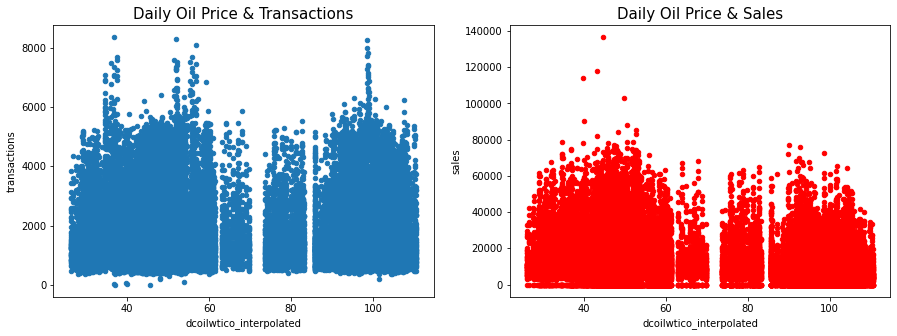

In [32]:
fig, axes = plt.subplots(1, 2, figsize=(15,5))
temp.plot.scatter(x='dcoilwtico_interpolated', y='transactions', ax=axes[0])
temp.plot.scatter(x='dcoilwtico_interpolated', y='sales', ax=axes[1], color='r')
axes[0].set_title('Daily Oil Price & Transactions', fontsize=15)
axes[1].set_title('Daily Oil Price & Sales', fontsize=15)

In [33]:
a = pd.merge(train.groupby(['date', 'family']).sales.sum().reset_index(), 
             oil.drop('dcoilwtico', axis = 1), how='left')
a.head()

,date,family,sales,dcoilwtico_interpolated
0,2013-01-01,AUTOMOTIVE,0.00,NaN
1,2013-01-01,BABY CARE,0.00,NaN
2,2013-01-01,BEAUTY,2.00,NaN
3,2013-01-01,BEVERAGES,810.00,NaN
4,2013-01-01,BOOKS,0.00,NaN


In [34]:
c = a.groupby('family').corr('spearman').reset_index()
c

,family,level_1,sales,dcoilwtico_interpolated
0,AUTOMOTIVE,sales,1.00,-0.44
1,AUTOMOTIVE,dcoilwtico_interpolated,-0.44,1.00
2,BABY CARE,sales,1.00,-0.62
3,BABY CARE,dcoilwtico_interpolated,-0.62,1.00
4,BEAUTY,sales,1.00,-0.54
...,...,...,...,...
61,PRODUCE,dcoilwtico_interpolated,-0.57,1.00
62,SCHOOL AND OFFICE SUPPLIES,sales,1.00,-0.62
63,SCHOOL AND OFFICE SUPPLIES,dcoilwtico_interpolated,-0.62,1.00
64,SEAFOOD,sales,1.00,-0.24


In [35]:
c = c[c.level_1 == 'dcoilwtico_interpolated'][['family','sales']].sort_values('sales')
c

,family,sales
33,HOME AND KITCHEN II,-0.79
47,MAGAZINES,-0.72
31,HOME AND KITCHEN I,-0.64
63,SCHOOL AND OFFICE SUPPLIES,-0.62
53,PET SUPPLIES,-0.62
3,BABY CARE,-0.62
7,BEVERAGES,-0.61
13,CELEBRATION,-0.61
55,PLAYERS AND ELECTRONICS,-0.58
37,HOME CARE,-0.57


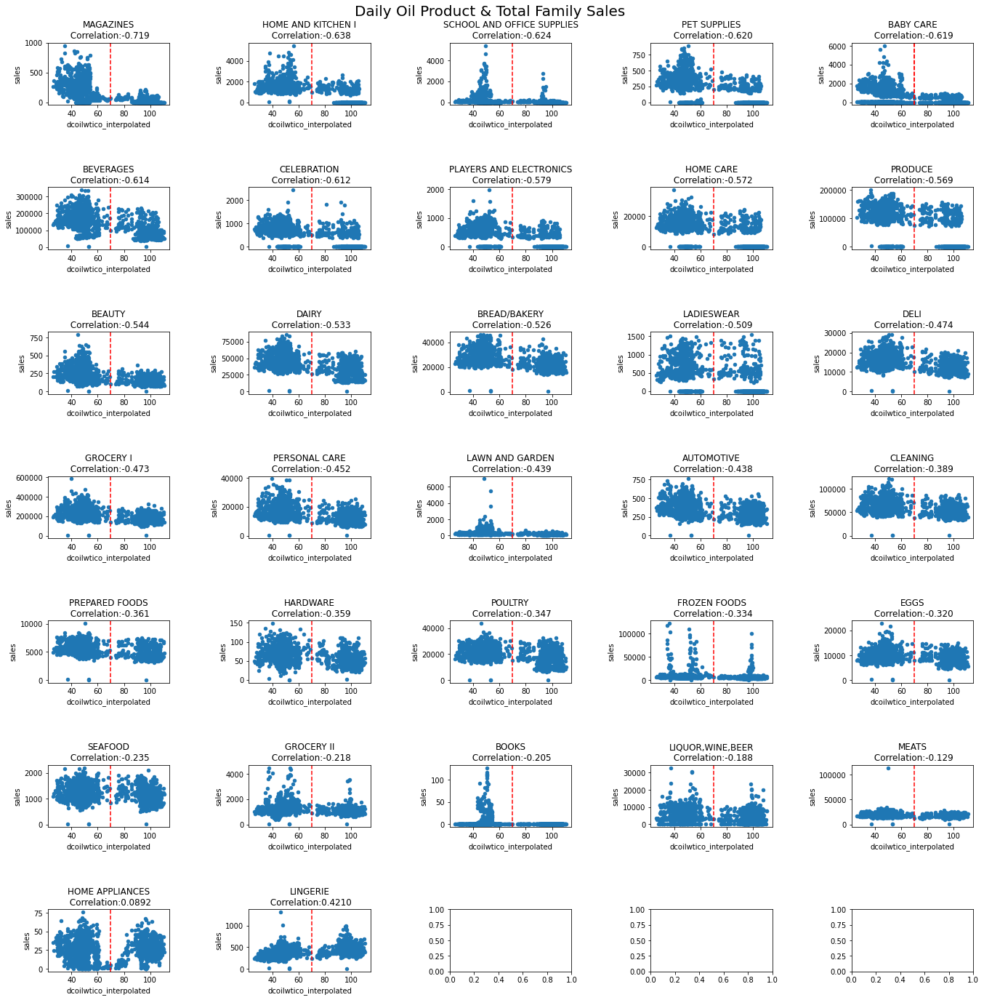

In [36]:
fig, axes = plt.subplots(7, 5, figsize = (20,20))
for i, fam in enumerate(c.family):
    if i < 6:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[0, i-1])
        axes[0, i-1].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[0, i-1].axvline(x=70, color='r', linestyle='--')
    if i >= 6 and i<11:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[1, i-6])
        axes[1, i-6].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[1, i-6].axvline(x=70, color='r', linestyle='--')
    if i >= 11 and i<16:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[2, i-11])
        axes[2, i-11].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[2, i-11].axvline(x=70, color='r', linestyle='--')
    if i >= 16 and i<21:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[3, i-16])
        axes[3, i-16].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[3, i-16].axvline(x=70, color='r', linestyle='--')
    if i >= 21 and i<26:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[4, i-21])
        axes[4, i-21].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[4, i-21].axvline(x=70, color='r', linestyle='--')
    if i >= 26 and i < 31:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[5, i-26])
        axes[5, i-26].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[5, i-26].axvline(x=70, color='r', linestyle='--')
    if i >= 31 :
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[6, i-31])
        axes[6, i-31].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[6, i-31].axvline(x=70, color='r', linestyle='--')
        
        
plt.tight_layout(pad=5)
plt.suptitle("Daily Oil Product & Total Family Sales \n", fontsize = 20);
plt.show()

## 4. Sales


In [37]:
a = train [['store_nbr', 'sales']]
a['ind'] = 1
a['ind'] = a.groupby('store_nbr').ind.cumsum().values
a

,store_nbr,sales,ind
0,1,0.00,1
1,1,0.00,2
2,1,0.00,3
3,1,0.00,4
4,1,0.00,5
...,...,...,...
3000883,9,438.13,55568
3000884,9,154.55,55569
3000885,9,2419.73,55570
3000886,9,121.00,55571


In [38]:
a = pd.pivot(a, index = 'ind', columns='store_nbr', values='sales').corr()
a

store_nbr,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54
store_nbr,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,1.00,0.75,0.90,0.88,0.86,0.85,0.95,0.91,0.75,0.73,0.78,0.76,0.75,0.75,0.82,0.73,0.80,0.78,0.77,0.54,0.59,0.57,0.88,0.91,0.73,0.66,0.86,0.77,0.66,0.81,0.78,0.66,0.81,0.80,0.63,0.82,0.94,0.85,0.75,0.81,0.85,0.69,0.78,0.88,0.85,0.76,0.85,0.72,0.90,0.82,0.92,0.27,0.76,0.71
2,0.75,1.00,0.81,0.83,0.80,0.82,0.77,0.81,0.77,0.73,0.77,0.75,0.72,0.71,0.76,0.73,0.79,0.76,0.75,0.59,0.60,0.57,0.79,0.77,0.64,0.63,0.81,0.78,0.64,0.75,0.77,0.64,0.78,0.76,0.61,0.77,0.80,0.79,0.73,0.77,0.80,0.62,0.75,0.80,0.82,0.79,0.82,0.77,0.80,0.80,0.80,0.23,0.71,0.73
3,0.90,0.81,1.00,0.98,0.91,0.96,0.96,0.99,0.85,0.78,0.85,0.81,0.78,0.76,0.82,0.80,0.89,0.87,0.84,0.63,0.68,0.61,0.92,0.93,0.78,0.71,0.97,0.89,0.74,0.85,0.86,0.69,0.87,0.85,0.68,0.87,0.95,0.92,0.82,0.85,0.93,0.76,0.86,0.99,0.96,0.90,0.97,0.87,0.99,0.91,0.98,0.29,0.83,0.81
4,0.88,0.83,0.98,1.00,0.95,0.99,0.92,0.98,0.91,0.86,0.90,0.87,0.84,0.83,0.88,0.87,0.93,0.89,0.88,0.66,0.69,0.64,0.94,0.91,0.77,0.75,0.97,0.93,0.75,0.88,0.91,0.75,0.92,0.89,0.72,0.90,0.95,0.95,0.86,0.89,0.95,0.73,0.88,0.97,0.98,0.95,0.99,0.93,0.96,0.96,0.96,0.27,0.83,0.86
5,0.86,0.80,0.91,0.95,1.00,0.95,0.85,0.91,0.93,0.92,0.93,0.90,0.90,0.90,0.93,0.94,0.92,0.87,0.90,0.60,0.62,0.58,0.93,0.88,0.76,0.79,0.92,0.92,0.67,0.90,0.94,0.80,0.96,0.94,0.73,0.90,0.95,0.96,0.86,0.92,0.94,0.61,0.88,0.90,0.93,0.94,0.94,0.93,0.89,0.96,0.91,0.24,0.76,0.90
6,0.85,0.82,0.96,0.99,0.95,1.00,0.89,0.96,0.94,0.89,0.93,0.90,0.87,0.86,0.90,0.89,0.95,0.90,0.91,0.68,0.72,0.66,0.94,0.90,0.76,0.77,0.97,0.95,0.77,0.90,0.93,0.78,0.93,0.92,0.74,0.91,0.94,0.95,0.87,0.92,0.96,0.73,0.91,0.96,0.98,0.97,0.99,0.96,0.95,0.97,0.94,0.28,0.82,0.89
7,0.95,0.77,0.96,0.92,0.85,0.89,1.00,0.96,0.76,0.69,0.76,0.73,0.70,0.69,0.77,0.72,0.81,0.81,0.74,0.56,0.62,0.56,0.89,0.92,0.74,0.64,0.92,0.81,0.68,0.79,0.77,0.62,0.80,0.77,0.62,0.82,0.94,0.86,0.75,0.78,0.87,0.75,0.78,0.94,0.89,0.79,0.89,0.75,0.96,0.82,0.96,0.28,0.79,0.71
8,0.91,0.81,0.99,0.98,0.91,0.96,0.96,1.00,0.85,0.79,0.84,0.81,0.78,0.77,0.83,0.80,0.88,0.87,0.83,0.62,0.67,0.61,0.92,0.93,0.78,0.72,0.97,0.89,0.73,0.85,0.86,0.70,0.87,0.85,0.67,0.87,0.95,0.93,0.82,0.85,0.93,0.75,0.85,0.99,0.96,0.90,0.97,0.87,0.98,0.92,0.98,0.29,0.83,0.80
9,0.75,0.77,0.85,0.91,0.93,0.94,0.76,0.85,1.00,0.96,0.96,0.93,0.92,0.91,0.93,0.93,0.96,0.87,0.93,0.70,0.71,0.67,0.89,0.80,0.68,0.78,0.88,0.94,0.75,0.90,0.95,0.82,0.94,0.93,0.74,0.91,0.87,0.91,0.87,0.94,0.91,0.64,0.90,0.85,0.92,0.96,0.93,0.96,0.83,0.96,0.82,0.25,0.76,0.92


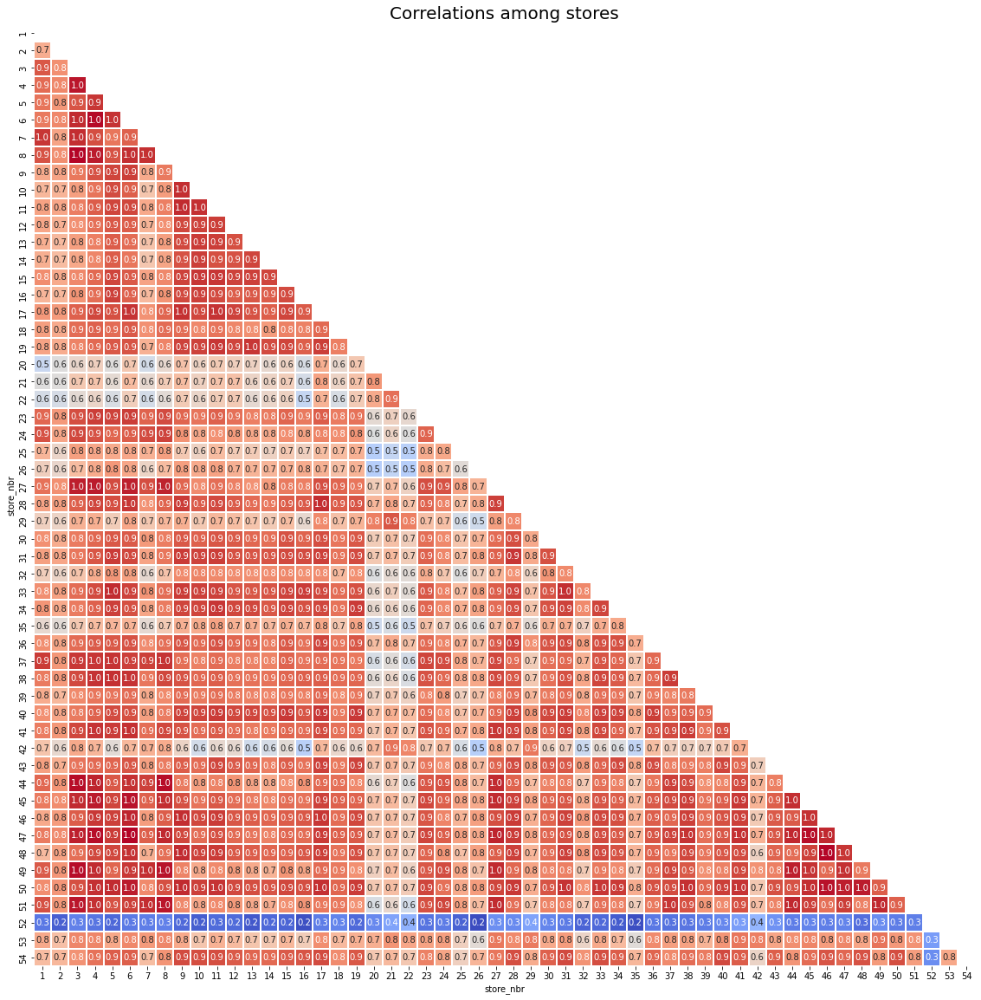

In [39]:
mask = np.triu(a.corr())
plt.figure(figsize=(20, 20))
sns.heatmap(a, annot=True, fmt='.1f', cmap='coolwarm', square=True, 
            mask=mask, linewidths=1, cbar=False)
plt.title('Correlations among stores', fontsize=20)
plt.show()

In [40]:
a = train.set_index('date').groupby('store_nbr').resample('D').sales.sum().reset_index()
px.line(a, x='date', y='sales', color='store_nbr', title='Daily Total Sales of the Stores')

If you select the stores 20, 21, 22, 29, 36, 42, 52 and 53, some of them have no sales at the beginning of 2013. So we better get rid of them.

In [41]:
print(train.shape)
train = train[~((train.store_nbr == 52) & (train.date < '2017-04-20'))]
train = train[~((train.store_nbr == 22) & (train.date < "2015-10-09"))]
train = train[~((train.store_nbr == 42) & (train.date < "2015-08-21"))]
train = train[~((train.store_nbr == 21) & (train.date < "2015-07-24"))]
train = train[~((train.store_nbr == 29) & (train.date < "2015-03-20"))]
train = train[~((train.store_nbr == 20) & (train.date < "2015-02-13"))]
train = train[~((train.store_nbr == 53) & (train.date < "2014-05-29"))]
train = train[~((train.store_nbr == 36) & (train.date < "2013-05-09"))]
train.shape


(3000888, 6)


(2780316, 6)

## 5. Zero Forecasting

* Some stores don't sell some product families. In the following code, you can see which products aren't sold in which stores. It isn't difficult to forecast them next 15 days. Their forecasts must be 0 next 15 days.

* Remove them from the data and create a new data frame for product families which never sell. 

In [42]:
c = train.groupby(['store_nbr', 'family']).sales.sum().reset_index().sort_values(['family', 'store_nbr'])
c.head()

,store_nbr,family,sales
0,1,AUTOMOTIVE,5475.00
33,2,AUTOMOTIVE,9100.00
66,3,AUTOMOTIVE,15647.00
99,4,AUTOMOTIVE,6767.00
132,5,AUTOMOTIVE,9194.00


In [43]:
c = c[c.sales == 0]
c

,store_nbr,family,sales
1,1,BABY CARE,0.00
397,13,BABY CARE,0.00
727,23,BABY CARE,0.00
1420,44,BABY CARE,0.00
1453,45,BABY CARE,0.00
1486,46,BABY CARE,0.00
1519,47,BABY CARE,0.00
1552,48,BABY CARE,0.00
1585,49,BABY CARE,0.00
1618,50,BABY CARE,0.00


In [44]:
print(train.shape)
# anti join
outer_join = train.merge(c[c.sales == 0].drop('sales', axis=1), 
                         how='outer', indicator=True)
train = outer_join[~(outer_join._merge == 'both')].drop('_merge', axis=1)
del outer_join
gc.collect()
train.shape

(2780316, 6)


(2698648, 6)

In [45]:
zero_prediction = []
for i in range(0, len(c)):
    zero_prediction.append(
        pd.DataFrame({
            'date':pd.date_range('2017-08-16', '2017-08-31').tolist(),
            'store_nbr': c.store_nbr.iloc[i],
            'family': c.family.iloc[i],
            'sales':0
        })
    )

In [46]:
zero_prediction = pd.concat(zero_prediction)
del c
gc.collect()
zero_prediction

,date,store_nbr,family,sales
0,2017-08-16,1,BABY CARE,0
1,2017-08-17,1,BABY CARE,0
2,2017-08-18,1,BABY CARE,0
3,2017-08-19,1,BABY CARE,0
4,2017-08-20,1,BABY CARE,0
...,...,...,...,...
11,2017-08-27,54,LAWN AND GARDEN,0
12,2017-08-28,54,LAWN AND GARDEN,0
13,2017-08-29,54,LAWN AND GARDEN,0
14,2017-08-30,54,LAWN AND GARDEN,0


## 6. Are the Product Families Active or Passive?

In [47]:
c = train.groupby(['family', 'store_nbr']).tail(60).groupby(['family',
                                                      'store_nbr']).sales.sum().reset_index()
c[c.sales==0]                                                  

,family,store_nbr,sales
54,BABY CARE,2,0.00
62,BABY CARE,10,0.00
64,BABY CARE,12,0.00
65,BABY CARE,14,0.00
76,BABY CARE,26,0.00
82,BABY CARE,32,0.00
83,BABY CARE,33,0.00
87,BABY CARE,37,0.00
88,BABY CARE,38,0.00
92,BABY CARE,42,0.00


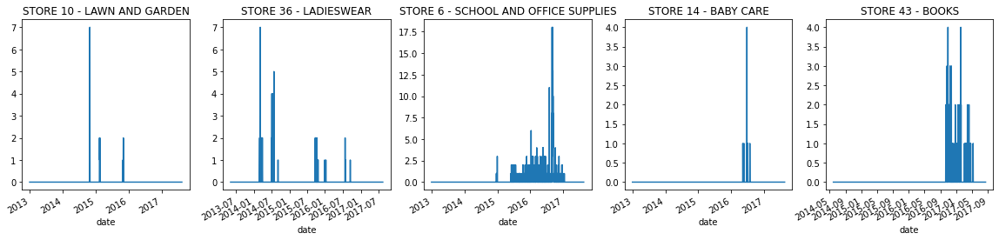

In [48]:
fig, ax = plt.subplots(1,5, figsize = (20,4))
train[(train.store_nbr == 10) & (train.family == "LAWN AND GARDEN")].set_index("date").sales.plot(ax = ax[0], title = "STORE 10 - LAWN AND GARDEN")
train[(train.store_nbr == 36) & (train.family == "LADIESWEAR")].set_index("date").sales.plot(ax = ax[1], title = "STORE 36 - LADIESWEAR")
train[(train.store_nbr == 6) & (train.family == "SCHOOL AND OFFICE SUPPLIES")].set_index("date").sales.plot(ax = ax[2], title = "STORE 6 - SCHOOL AND OFFICE SUPPLIES")
train[(train.store_nbr == 14) & (train.family == "BABY CARE")].set_index("date").sales.plot(ax = ax[3], title = "STORE 14 - BABY CARE")
train[(train.store_nbr == 53) & (train.family == "BOOKS")].set_index("date").sales.plot(ax = ax[4], title = "STORE 43 - BOOKS")
plt.show()

In [49]:
a = train.set_index('date').groupby('family').resample('D').sales.sum().reset_index()

In [50]:
px.line(a, x='date', y='sales', color='family', 
        title='Daily Total Sales of the Family')

In [51]:
a=train.groupby('family').sales.mean().sort_values(ascending=False).reset_index()
px.bar(a, y='family', x='sales', color='family', 
      title='Which Product Family Preferred More?')

In [52]:
print('Spearman Correlation between Sales and Onpromotion: {:,.4f}'.format(train.corr('spearman').sales.loc['onpromotion']))

Spearman Correlation between Sales and Onpromotion: 0.5304


In [53]:
d = pd.merge(train, stores)
d['store_nbr'] = d['store_nbr'].astype('int8')
d['year'] = d.date.dt.year
px.line(d.groupby(['city', 'year']).sales.mean().reset_index(), 
        x='year', y='sales', color='city')

## 7. Holidays and Events


In [54]:
holidays = pd.read_csv('/content/drive/MyDrive/DS Projects/Time Series Kaggle/data/holidays_events.csv')

In [55]:
holidays['date'] = pd.to_datetime(holidays.date)
holidays

,date,type,locale,locale_name,description,transferred
0,2012-03-02,Holiday,Local,Manta,Fundacion de Manta,False
1,2012-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi,False
2,2012-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,False
3,2012-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad,False
4,2012-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba,False
...,...,...,...,...,...,...
345,2017-12-22,Additional,National,Ecuador,Navidad-3,False
346,2017-12-23,Additional,National,Ecuador,Navidad-2,False
347,2017-12-24,Additional,National,Ecuador,Navidad-1,False
348,2017-12-25,Holiday,National,Ecuador,Navidad,False


In [56]:
# transferred holidays
tr1 = holidays[(holidays.type=='Holiday') & (holidays.transferred==True)].drop('transferred', axis=1).reset_index(drop=True)
tr1

,date,type,locale,locale_name,description
0,2012-10-09,Holiday,National,Ecuador,Independencia de Guayaquil
1,2013-10-09,Holiday,National,Ecuador,Independencia de Guayaquil
2,2014-10-09,Holiday,National,Ecuador,Independencia de Guayaquil
3,2016-05-24,Holiday,National,Ecuador,Batalla de Pichincha
4,2016-07-25,Holiday,Local,Guayaquil,Fundacion de Guayaquil
5,2016-08-10,Holiday,National,Ecuador,Primer Grito de Independencia
6,2017-01-01,Holiday,National,Ecuador,Primer dia del ano
7,2017-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca
8,2017-05-24,Holiday,National,Ecuador,Batalla de Pichincha
9,2017-08-10,Holiday,National,Ecuador,Primer Grito de Independencia


In [57]:
tr2 = holidays[(holidays.type == "Transfer")].drop("transferred", axis = 1).reset_index(drop = True)
tr2

,date,type,locale,locale_name,description
0,2012-10-12,Transfer,National,Ecuador,Traslado Independencia de Guayaquil
1,2013-10-11,Transfer,National,Ecuador,Traslado Independencia de Guayaquil
2,2014-10-10,Transfer,National,Ecuador,Traslado Independencia de Guayaquil
3,2016-05-27,Transfer,National,Ecuador,Traslado Batalla de Pichincha
4,2016-07-24,Transfer,Local,Guayaquil,Traslado Fundacion de Guayaquil
5,2016-08-12,Transfer,National,Ecuador,Traslado Primer Grito de Independencia
6,2017-01-02,Transfer,National,Ecuador,Traslado Primer dia del ano
7,2017-04-13,Transfer,Local,Cuenca,Fundacion de Cuenca
8,2017-05-26,Transfer,National,Ecuador,Traslado Batalla de Pichincha
9,2017-08-11,Transfer,National,Ecuador,Traslado Primer Grito de Independencia


In [58]:
tr = pd.concat([tr1, tr2], axis=1)
tr

,date,type,locale,locale_name,description,date,type,locale,locale_name,description
0,2012-10-09,Holiday,National,Ecuador,Independencia de Guayaquil,2012-10-12,Transfer,National,Ecuador,Traslado Independencia de Guayaquil
1,2013-10-09,Holiday,National,Ecuador,Independencia de Guayaquil,2013-10-11,Transfer,National,Ecuador,Traslado Independencia de Guayaquil
2,2014-10-09,Holiday,National,Ecuador,Independencia de Guayaquil,2014-10-10,Transfer,National,Ecuador,Traslado Independencia de Guayaquil
3,2016-05-24,Holiday,National,Ecuador,Batalla de Pichincha,2016-05-27,Transfer,National,Ecuador,Traslado Batalla de Pichincha
4,2016-07-25,Holiday,Local,Guayaquil,Fundacion de Guayaquil,2016-07-24,Transfer,Local,Guayaquil,Traslado Fundacion de Guayaquil
5,2016-08-10,Holiday,National,Ecuador,Primer Grito de Independencia,2016-08-12,Transfer,National,Ecuador,Traslado Primer Grito de Independencia
6,2017-01-01,Holiday,National,Ecuador,Primer dia del ano,2017-01-02,Transfer,National,Ecuador,Traslado Primer dia del ano
7,2017-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,2017-04-13,Transfer,Local,Cuenca,Fundacion de Cuenca
8,2017-05-24,Holiday,National,Ecuador,Batalla de Pichincha,2017-05-26,Transfer,National,Ecuador,Traslado Batalla de Pichincha
9,2017-08-10,Holiday,National,Ecuador,Primer Grito de Independencia,2017-08-11,Transfer,National,Ecuador,Traslado Primer Grito de Independencia


In [59]:
tr = tr.iloc[:, [5,1,2,3,4]]
tr

,date,type,locale,locale_name,description
0,2012-10-12,Holiday,National,Ecuador,Independencia de Guayaquil
1,2013-10-11,Holiday,National,Ecuador,Independencia de Guayaquil
2,2014-10-10,Holiday,National,Ecuador,Independencia de Guayaquil
3,2016-05-27,Holiday,National,Ecuador,Batalla de Pichincha
4,2016-07-24,Holiday,Local,Guayaquil,Fundacion de Guayaquil
5,2016-08-12,Holiday,National,Ecuador,Primer Grito de Independencia
6,2017-01-02,Holiday,National,Ecuador,Primer dia del ano
7,2017-04-13,Holiday,Local,Cuenca,Fundacion de Cuenca
8,2017-05-26,Holiday,National,Ecuador,Batalla de Pichincha
9,2017-08-11,Holiday,National,Ecuador,Primer Grito de Independencia


In [60]:
holidays

,date,type,locale,locale_name,description,transferred
0,2012-03-02,Holiday,Local,Manta,Fundacion de Manta,False
1,2012-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi,False
2,2012-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,False
3,2012-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad,False
4,2012-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba,False
...,...,...,...,...,...,...
345,2017-12-22,Additional,National,Ecuador,Navidad-3,False
346,2017-12-23,Additional,National,Ecuador,Navidad-2,False
347,2017-12-24,Additional,National,Ecuador,Navidad-1,False
348,2017-12-25,Holiday,National,Ecuador,Navidad,False


In [61]:
holidays = pd.read_csv('/content/drive/MyDrive/DS Projects/Time Series Kaggle/data/holidays_events.csv')
holidays['date'] = pd.to_datetime(holidays.date)
holidays = holidays[(holidays.transferred == False) & (holidays.type != "Transfer")].drop("transferred", axis = 1)
holidays = holidays.append(tr).reset_index(drop = True)

In [62]:
# additional holidays
holidays['description'] = holidays['description'].str.replace('-', '').str.replace('+', '').str.replace('\d+', '')
holidays['type'] = np.where(holidays['type'] == 'Additional', 'Holiday', holidays['type'])
holidays

,date,type,locale,locale_name,description
0,2012-03-02,Holiday,Local,Manta,Fundacion de Manta
1,2012-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi
2,2012-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca
3,2012-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad
4,2012-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba
...,...,...,...,...,...
333,2017-04-13,Holiday,Local,Cuenca,Fundacion de Cuenca
334,2017-05-26,Holiday,National,Ecuador,Batalla de Pichincha
335,2017-08-11,Holiday,National,Ecuador,Primer Grito de Independencia
336,2017-09-29,Holiday,Local,Ibarra,Fundacion de Ibarra


In [63]:
# Bridge Holidays
holidays["description"] = holidays["description"].str.replace("Puente ", "")
holidays["type"] = np.where(holidays["type"] == "Bridge", "Holiday", holidays["type"])

In [64]:
# Work Day Holidays, that is meant to payback the Bridge.
work_day = holidays[holidays.type == 'Work Day']
holidays = holidays[holidays.type != "Work Day"] 

In [65]:
# split
# events are national
events = holidays[holidays.type == 'Event'].drop(['type', 'locale', 'locale_name']
                                                 , axis=1).rename({'description':'events'}, axis = 1)
events                                            

,date,events
53,2013-05-12,Dia de la Madre
99,2014-05-11,Dia de la Madre
102,2014-06-12,Inauguracion Mundial de futbol Brasil
103,2014-06-15,Mundial de futbol Brasil: EcuadorSuiza
104,2014-06-20,Mundial de futbol Brasil: EcuadorHonduras
109,2014-06-25,Mundial de futbol Brasil: EcuadorFrancia
110,2014-06-28,Mundial de futbol Brasil: Octavos de Final
111,2014-06-29,Mundial de futbol Brasil: Octavos de Final
112,2014-06-30,Mundial de futbol Brasil: Octavos de Final
113,2014-07-01,Mundial de futbol Brasil: Octavos de Final


In [66]:
holidays = holidays[holidays.type != "Event"].drop("type", axis = 1)
regional = holidays[holidays.locale == "Regional"].rename({"locale_name":"state", "description":"holiday_regional"}, axis = 1).drop("locale", axis = 1).drop_duplicates()
national = holidays[holidays.locale == "National"].rename({"description":"holiday_national"}, axis = 1).drop(["locale", "locale_name"], axis = 1).drop_duplicates()
local = holidays[holidays.locale == "Local"].rename({"description":"holiday_local", "locale_name":"city"}, axis = 1).drop("locale", axis = 1).drop_duplicates()

In [67]:
d = pd.merge(train.append(test), stores)
d['store_nbr'] = d['store_nbr'].astype('int8')

In [68]:
d = pd.merge(d, national, how = 'left')
d = pd.merge(d, regional, how = 'left', on = ['date', 'state'])
d = pd.merge(d, local, how='left', on=['date', 'city'])
d

,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,holiday_national,holiday_regional,holiday_local
0,0,2013-01-01,1,AUTOMOTIVE,0.00,0.00,Quito,Pichincha,D,13,Primer dia del ano,NaN,NaN
1,1782,2013-01-02,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,NaN,NaN,NaN
2,3564,2013-01-03,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,NaN,NaN,NaN
3,5346,2013-01-04,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,NaN,NaN,NaN
4,7128,2013-01-05,1,AUTOMOTIVE,5.00,0.00,Quito,Pichincha,D,13,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2727155,3029197,2017-08-31,52,POULTRY,NaN,0.00,Manta,Manabi,A,11,NaN,NaN,NaN
2727156,3029198,2017-08-31,52,PREPARED FOODS,NaN,0.00,Manta,Manabi,A,11,NaN,NaN,NaN
2727157,3029199,2017-08-31,52,PRODUCE,NaN,3.00,Manta,Manabi,A,11,NaN,NaN,NaN
2727158,3029200,2017-08-31,52,SCHOOL AND OFFICE SUPPLIES,NaN,0.00,Manta,Manabi,A,11,NaN,NaN,NaN


In [69]:
# Work Day: It will be removed when real work day colum created
d = pd.merge(d,  work_day[["date", "type"]].rename({"type":"IsWorkDay"}, axis = 1),how = "left")

# EVENTS
events["events"] =np.where(events.events.str.contains("futbol"), "Futbol", events.events)

In [70]:
def one_hot_encoder(df, nan_as_category=True):
    original_columns = list(df.columns)
    categorical_columns = df.select_dtypes(["category", "object"]).columns.tolist()
    # categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
    df = pd.get_dummies(df, columns=categorical_columns, dummy_na=nan_as_category)
    new_columns = [c for c in df.columns if c not in original_columns]
    df.columns = df.columns.str.replace(" ", "_")
    return df, df.columns.tolist()

In [71]:
events, events_cat = one_hot_encoder(events, nan_as_category=False)
events

,date,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi
53,2013-05-12,0,0,1,0,0
99,2014-05-11,0,0,1,0,0
102,2014-06-12,0,0,0,1,0
103,2014-06-15,0,0,0,1,0
104,2014-06-20,0,0,0,1,0
109,2014-06-25,0,0,0,1,0
110,2014-06-28,0,0,0,1,0
111,2014-06-29,0,0,0,1,0
112,2014-06-30,0,0,0,1,0
113,2014-07-01,0,0,0,1,0


In [72]:
events, events_cat = one_hot_encoder(events, nan_as_category=False)

In [73]:
d = pd.merge(d, events, how = "left")
d[events_cat] = d[events_cat].fillna(0)
d

,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,holiday_national,holiday_regional,holiday_local,IsWorkDay,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi
0,0,2013-01-01,1,AUTOMOTIVE,0.00,0.00,Quito,Pichincha,D,13,Primer dia del ano,NaN,NaN,NaN,0.00,0.00,0.00,0.00,0.00
1,1782,2013-01-02,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,0.00
2,3564,2013-01-03,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,0.00
3,5346,2013-01-04,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,0.00
4,7128,2013-01-05,1,AUTOMOTIVE,5.00,0.00,Quito,Pichincha,D,13,NaN,NaN,NaN,Work Day,0.00,0.00,0.00,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2728853,3029197,2017-08-31,52,POULTRY,NaN,0.00,Manta,Manabi,A,11,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,0.00
2728854,3029198,2017-08-31,52,PREPARED FOODS,NaN,0.00,Manta,Manabi,A,11,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,0.00
2728855,3029199,2017-08-31,52,PRODUCE,NaN,3.00,Manta,Manabi,A,11,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,0.00
2728856,3029200,2017-08-31,52,SCHOOL AND OFFICE SUPPLIES,NaN,0.00,Manta,Manabi,A,11,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,0.00


In [74]:
# new features
d['holiday_national_binary'] = np.where(d.holiday_national.notnull(), 1, 0)
d['holiday_local_binary'] = np.where(d.holiday_local.notnull(), 1, 0)
d["holiday_regional_binary"] = np.where(d.holiday_regional.notnull(), 1, 0)

In [75]:
d['national_indenpendence'] = np.where(d.holiday_national.isin(['Batalla de Pichincha',  'Independencia de Cuenca', 'Independencia de Guayaquil', 'Independencia de Guayaquil', 'Primer Grito de Independencia']), 1, 0)

In [76]:
d['local_cantonizacio'] = np.where(d.holiday_local.str.contains('Cantonizacio'), 1, 0)
d["local_fundacion"] = np.where(d.holiday_local.str.contains("Fundacion"), 1, 0)
d["local_independencia"] = np.where(d.holiday_local.str.contains("Independencia"), 1, 0)

In [77]:
holidays, holidays_cat = one_hot_encoder(d[["holiday_national","holiday_regional","holiday_local"]], nan_as_category=False)
holidays

,holiday_national_Batalla_de_Pichincha,holiday_national_Carnaval,holiday_national_Dia_de_Difuntos,holiday_national_Dia_de_la_Madre,holiday_national_Dia_del_Trabajo,holiday_national_Independencia_de_Cuenca,holiday_national_Independencia_de_Guayaquil,holiday_national_Navidad,holiday_national_Primer_Grito_de_Independencia,holiday_national_Primer_dia_del_ano,holiday_national_Viernes_Santo,holiday_regional_Provincializacion_Santa_Elena,holiday_regional_Provincializacion_de_Cotopaxi,holiday_regional_Provincializacion_de_Imbabura,holiday_regional_Provincializacion_de_Santo_Domingo,holiday_local_Cantonizacion_de_Cayambe,holiday_local_Cantonizacion_de_El_Carmen,holiday_local_Cantonizacion_de_Guaranda,holiday_local_Cantonizacion_de_Latacunga,holiday_local_Cantonizacion_de_Libertad,holiday_local_Cantonizacion_de_Quevedo,holiday_local_Cantonizacion_de_Riobamba,holiday_local_Cantonizacion_de_Salinas,holiday_local_Cantonizacion_del_Puyo,holiday_local_Fundacion_de_Ambato,holiday_local_Fundacion_de_Cuenca,holiday_local_Fundacion_de_Esmeraldas,holiday_local_Fundacion_de_Guayaquil,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga
0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2728853,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2728854,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2728855,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2728856,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [78]:
d = pd.concat([d.drop(['holiday_national', 'holiday_regional',
                       'holiday_local'], axis=1), holidays], axis=1)

In [79]:
d

,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,IsWorkDay,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,holiday_national_binary,holiday_local_binary,holiday_regional_binary,national_indenpendence,local_cantonizacio,local_fundacion,local_independencia,holiday_national_Batalla_de_Pichincha,holiday_national_Carnaval,holiday_national_Dia_de_Difuntos,holiday_national_Dia_de_la_Madre,holiday_national_Dia_del_Trabajo,holiday_national_Independencia_de_Cuenca,holiday_national_Independencia_de_Guayaquil,holiday_national_Navidad,holiday_national_Primer_Grito_de_Independencia,holiday_national_Primer_dia_del_ano,holiday_national_Viernes_Santo,holiday_regional_Provincializacion_Santa_Elena,holiday_regional_Provincializacion_de_Cotopaxi,holiday_regional_Provincializacion_de_Imbabura,holiday_regional_Provincializacion_de_Santo_Domingo,holiday_local_Cantonizacion_de_Cayambe,holiday_local_Cantonizacion_de_El_Carmen,holiday_local_Cantonizacion_de_Guaranda,holiday_local_Cantonizacion_de_Latacunga,holiday_local_Cantonizacion_de_Libertad,holiday_local_Cantonizacion_de_Quevedo,holiday_local_Cantonizacion_de_Riobamba,holiday_local_Cantonizacion_de_Salinas,holiday_local_Cantonizacion_del_Puyo,holiday_local_Fundacion_de_Ambato,holiday_local_Fundacion_de_Cuenca,holiday_local_Fundacion_de_Esmeraldas,holiday_local_Fundacion_de_Guayaquil,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga
0,0,2013-01-01,1,AUTOMOTIVE,0.00,0.00,Quito,Pichincha,D,13,NaN,0.00,0.00,0.00,0.00,0.00,1,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1782,2013-01-02,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,NaN,0.00,0.00,0.00,0.00,0.00,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,3564,2013-01-03,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,NaN,0.00,0.00,0.00,0.00,0.00,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,5346,2013-01-04,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,NaN,0.00,0.00,0.00,0.00,0.00,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,7128,2013-01-05,1,AUTOMOTIVE,5.00,0.00,Quito,Pichincha,D,13,Work Day,0.00,0.00,0.00,0.00,0.00,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2728853,3029197,2017-08-31,52,POULTRY,NaN,0.00,Manta,Manabi,A,11,NaN,0.00,0.00,0.00,0.00,0.00,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2728854,3029198,2017-08-31,52,PREPARED FOODS,NaN,0.00,Manta,Manabi,A,11,NaN,0.00,0.00,0.00,0.00,0.00,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2728855,3029199,2017-08-31,52,PRODUCE,NaN,3.00,Manta,Manabi,A,11,NaN,0.00,0.00,0.00,0.00,0.00,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2728856,3029200,2017-08-31,52,SCHOOL AND OFFICE SUPPLIES,NaN,0.00,Manta,Manabi,A,11,NaN,0.00,0.00,0.00,0.00,0.00,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [80]:
he_cols = d.columns[d.columns.str.startswith("events")].tolist() + d.columns[d.columns.str.startswith("holiday")].tolist() + d.columns[d.columns.str.startswith("national")].tolist()+ d.columns[d.columns.str.startswith("local")].tolist()
d[he_cols] = d[he_cols].astype("int8")
d

,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,IsWorkDay,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,holiday_national_binary,holiday_local_binary,holiday_regional_binary,national_indenpendence,local_cantonizacio,local_fundacion,local_independencia,holiday_national_Batalla_de_Pichincha,holiday_national_Carnaval,holiday_national_Dia_de_Difuntos,holiday_national_Dia_de_la_Madre,holiday_national_Dia_del_Trabajo,holiday_national_Independencia_de_Cuenca,holiday_national_Independencia_de_Guayaquil,holiday_national_Navidad,holiday_national_Primer_Grito_de_Independencia,holiday_national_Primer_dia_del_ano,holiday_national_Viernes_Santo,holiday_regional_Provincializacion_Santa_Elena,holiday_regional_Provincializacion_de_Cotopaxi,holiday_regional_Provincializacion_de_Imbabura,holiday_regional_Provincializacion_de_Santo_Domingo,holiday_local_Cantonizacion_de_Cayambe,holiday_local_Cantonizacion_de_El_Carmen,holiday_local_Cantonizacion_de_Guaranda,holiday_local_Cantonizacion_de_Latacunga,holiday_local_Cantonizacion_de_Libertad,holiday_local_Cantonizacion_de_Quevedo,holiday_local_Cantonizacion_de_Riobamba,holiday_local_Cantonizacion_de_Salinas,holiday_local_Cantonizacion_del_Puyo,holiday_local_Fundacion_de_Ambato,holiday_local_Fundacion_de_Cuenca,holiday_local_Fundacion_de_Esmeraldas,holiday_local_Fundacion_de_Guayaquil,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga
0,0,2013-01-01,1,AUTOMOTIVE,0.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,1,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1782,2013-01-02,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,3564,2013-01-03,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,5346,2013-01-04,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,7128,2013-01-05,1,AUTOMOTIVE,5.00,0.00,Quito,Pichincha,D,13,Work Day,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2728853,3029197,2017-08-31,52,POULTRY,NaN,0.00,Manta,Manabi,A,11,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2728854,3029198,2017-08-31,52,PREPARED FOODS,NaN,0.00,Manta,Manabi,A,11,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2728855,3029199,2017-08-31,52,PRODUCE,NaN,3.00,Manta,Manabi,A,11,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2728856,3029200,2017-08-31,52,SCHOOL AND OFFICE SUPPLIES,NaN,0.00,Manta,Manabi,A,11,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [81]:
d[['family', 'city', 'state', 'type']] = d[['family', 'city',
                                            'state', 'type']].astype('category')

In [82]:
del holidays, holidays_cat, work_day, local, regional, national, events, events_cat, tr, tr1, tr2, he_cols

In [83]:
gc.collect()

66

In [84]:
d.head()

,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,IsWorkDay,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,holiday_national_binary,holiday_local_binary,holiday_regional_binary,national_indenpendence,local_cantonizacio,local_fundacion,local_independencia,holiday_national_Batalla_de_Pichincha,holiday_national_Carnaval,holiday_national_Dia_de_Difuntos,holiday_national_Dia_de_la_Madre,holiday_national_Dia_del_Trabajo,holiday_national_Independencia_de_Cuenca,holiday_national_Independencia_de_Guayaquil,holiday_national_Navidad,holiday_national_Primer_Grito_de_Independencia,holiday_national_Primer_dia_del_ano,holiday_national_Viernes_Santo,holiday_regional_Provincializacion_Santa_Elena,holiday_regional_Provincializacion_de_Cotopaxi,holiday_regional_Provincializacion_de_Imbabura,holiday_regional_Provincializacion_de_Santo_Domingo,holiday_local_Cantonizacion_de_Cayambe,holiday_local_Cantonizacion_de_El_Carmen,holiday_local_Cantonizacion_de_Guaranda,holiday_local_Cantonizacion_de_Latacunga,holiday_local_Cantonizacion_de_Libertad,holiday_local_Cantonizacion_de_Quevedo,holiday_local_Cantonizacion_de_Riobamba,holiday_local_Cantonizacion_de_Salinas,holiday_local_Cantonizacion_del_Puyo,holiday_local_Fundacion_de_Ambato,holiday_local_Fundacion_de_Cuenca,holiday_local_Fundacion_de_Esmeraldas,holiday_local_Fundacion_de_Guayaquil,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga
0,0,2013-01-01,1,AUTOMOTIVE,0.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,1,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1782,2013-01-02,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,3564,2013-01-03,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,5346,2013-01-04,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,7128,2013-01-05,1,AUTOMOTIVE,5.00,0.00,Quito,Pichincha,D,13,Work Day,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


## 8. AB test

In [85]:
def AB_Test(dataframe, group, target):
    
    # Packages
    from scipy.stats import shapiro
    import scipy.stats as stats
    
    # Split A/B
    groupA = dataframe[dataframe[group] == 1][target]
    groupB = dataframe[dataframe[group] == 0][target]
    
    # Assumption: Normality
    ntA = shapiro(groupA)[1] < 0.05
    ntB = shapiro(groupB)[1] < 0.05
    # H0: Distribution is Normal! - False
    # H1: Distribution is not Normal! - True
    
    if (ntA == False) & (ntB == False): # "H0: Normal Distribution"
        # Parametric Test
        # Assumption: Homogeneity of variances
        leveneTest = stats.levene(groupA, groupB)[1] < 0.05
        # H0: Homogeneity: False
        # H1: Heterogeneous: True
        
        if leveneTest == False:
            # Homogeneity
            ttest = stats.ttest_ind(groupA, groupB, equal_var=True)[1]
            # H0: M1 == M2 - False
            # H1: M1 != M2 - True
        else:
            # Heterogeneous
            ttest = stats.ttest_ind(groupA, groupB, equal_var=False)[1]
            # H0: M1 == M2 - False
            # H1: M1 != M2 - True
    else:
        # Non-Parametric Test
        ttest = stats.mannwhitneyu(groupA, groupB)[1] 
        # H0: M1 == M2 - False
        # H1: M1 != M2 - True
        
    # Result
    temp = pd.DataFrame({
        "AB Hypothesis":[ttest < 0.05], 
        "p-value":[ttest]
    })
    temp["Test Type"] = np.where((ntA == False) & (ntB == False), "Parametric", "Non-Parametric")
    temp["AB Hypothesis"] = np.where(temp["AB Hypothesis"] == False, "Fail to Reject H0", "Reject H0")
    temp["Comment"] = np.where(temp["AB Hypothesis"] == "Fail to Reject H0", "A/B groups are similar!", "A/B groups are not similar!")
    temp["Feature"] = group
    temp["GroupA_mean"] = groupA.mean()
    temp["GroupB_mean"] = groupB.mean()
    temp["GroupA_median"] = groupA.median()
    temp["GroupB_median"] = groupB.median()
    
    # Columns
    if (ntA == False) & (ntB == False):
        temp["Homogeneity"] = np.where(leveneTest == False, "Yes", "No")
        temp = temp[["Feature","Test Type", "Homogeneity","AB Hypothesis", "p-value", "Comment", "GroupA_mean", "GroupB_mean", "GroupA_median", "GroupB_median"]]
    else:
        temp = temp[["Feature","Test Type","AB Hypothesis", "p-value", "Comment", "GroupA_mean", "GroupB_mean", "GroupA_median", "GroupB_median"]]
    
    # Print Hypothesis
    # print("# A/B Testing Hypothesis")
    # print("H0: A == B")
    # print("H1: A != B", "\n")
    
    return temp

In [86]:
# apply A/B testing
d.columns[d.columns.str.startswith("events")].tolist()

['events_Black_Friday',
 'events_Cyber_Monday',
 'events_Dia_de_la_Madre',
 'events_Futbol',
 'events_Terremoto_Manabi']

In [87]:
he_cols = d.columns[d.columns.str.startswith("events")].tolist() + d.columns[d.columns.str.startswith("holiday")].tolist() + d.columns[d.columns.str.startswith("national")].tolist()+ d.columns[d.columns.str.startswith("local")].tolist()
he_cols

['events_Black_Friday',
 'events_Cyber_Monday',
 'events_Dia_de_la_Madre',
 'events_Futbol',
 'events_Terremoto_Manabi',
 'holiday_national_binary',
 'holiday_local_binary',
 'holiday_regional_binary',
 'holiday_national_Batalla_de_Pichincha',
 'holiday_national_Carnaval',
 'holiday_national_Dia_de_Difuntos',
 'holiday_national_Dia_de_la_Madre',
 'holiday_national_Dia_del_Trabajo',
 'holiday_national_Independencia_de_Cuenca',
 'holiday_national_Independencia_de_Guayaquil',
 'holiday_national_Navidad',
 'holiday_national_Primer_Grito_de_Independencia',
 'holiday_national_Primer_dia_del_ano',
 'holiday_national_Viernes_Santo',
 'holiday_regional_Provincializacion_Santa_Elena',
 'holiday_regional_Provincializacion_de_Cotopaxi',
 'holiday_regional_Provincializacion_de_Imbabura',
 'holiday_regional_Provincializacion_de_Santo_Domingo',
 'holiday_local_Cantonizacion_de_Cayambe',
 'holiday_local_Cantonizacion_de_El_Carmen',
 'holiday_local_Cantonizacion_de_Guaranda',
 'holiday_local_Cantonizac

In [88]:
ab = []
for i in he_cols:
    ab.append(AB_Test(dataframe=d[d.sales.notnull()], 
                      group=i, target='sales'))


In [89]:
ab = pd.concat(ab)
ab

,Feature,Test Type,AB Hypothesis,p-value,Comment,GroupA_mean,GroupB_mean,GroupA_median,GroupB_median
0,events_Black_Friday,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,393.70,397.91,26.58,19.00
0,events_Cyber_Monday,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,472.65,397.76,24.00,19.00
0,events_Dia_de_la_Madre,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,386.35,397.93,17.00,19.00
0,events_Futbol,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,360.30,398.20,13.00,19.00
0,events_Terremoto_Manabi,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,519.39,395.48,30.00,19.00
0,holiday_national_binary,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,471.42,394.33,20.00,19.00
0,holiday_local_binary,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,472.89,397.60,24.00,19.00
0,holiday_regional_binary,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,254.61,397.95,11.00,19.00
0,holiday_national_Batalla_de_Pichincha,Non-Parametric,Fail to Reject H0,0.62,A/B groups are similar!,434.22,397.79,21.00,19.00
0,holiday_national_Carnaval,Non-Parametric,Fail to Reject H0,0.18,A/B groups are similar!,373.36,398.04,19.00,19.00


In [90]:
d.groupby(['family', 'events_Futbol']).sales.mean()[:60]

family                   events_Futbol
AUTOMOTIVE               0                  6.59
                         1                  6.20
BABY CARE                0                  0.15
                         1                  0.09
BEAUTY                   0                  4.02
                         1                  2.89
BEVERAGES                0               2578.41
                         1               2243.45
BOOKS                    0                  0.15
                         1                  0.00
BREAD/BAKERY             0                500.54
                         1                451.53
CELEBRATION              0                  9.06
                         1                  6.43
CLEANING                 0               1157.92
                         1               1102.08
DAIRY                    0                765.62
                         1                759.26
DELI                     0                286.38
                         1    

## 9. Time Related Features

In [91]:
# time related features
def create_date_features(df):
    df['month'] = df.date.dt.month.astype('int8')
    df['day_of_month'] = df.date.dt.day.astype('int8')
    df['day_of_year'] = df.date.dt.dayofyear.astype('int16')
    df['week_of_month'] = (df.date.apply(lambda d: (d.day-1) // 7 + 1)).astype('int8')
    df['week_of_year'] = (df.date.dt.weekofyear).astype('int8')
    df['day_of_week'] = (df.date.dt.dayofweek + 1).astype('int8')
    df['year'] = df.date.dt.year.astype("int32")
    df["is_wknd"] = (df.date.dt.weekday // 4).astype("int8")
    df["quarter"] = df.date.dt.quarter.astype("int8")
    df['is_month_start'] = df.date.dt.is_month_start.astype("int8")
    df['is_month_end'] = df.date.dt.is_month_end.astype("int8")
    df['is_quarter_start'] = df.date.dt.is_quarter_start.astype("int8")
    df['is_quarter_end'] = df.date.dt.is_quarter_end.astype("int8")
    df['is_year_start'] = df.date.dt.is_year_start.astype("int8")
    df['is_year_end'] = df.date.dt.is_year_end.astype("int8")

    # 0: Winter, 1: Spring, 2: Summer, 3: Fall
    df['season'] = np.where(df.month.isin([12, 1, 2]), 0 ,1)
    df['season'] = np.where(df.month.isin([6,7,8]), 2, df['season'])
    df['season'] = pd.Series(np.where(df.month.isin([9, 10, 11]), 3, df['season'])).astype('int8')
    return df


In [92]:
d = create_date_features(d)
d.head()

,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,IsWorkDay,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,holiday_national_binary,holiday_local_binary,holiday_regional_binary,national_indenpendence,local_cantonizacio,local_fundacion,local_independencia,holiday_national_Batalla_de_Pichincha,holiday_national_Carnaval,holiday_national_Dia_de_Difuntos,holiday_national_Dia_de_la_Madre,holiday_national_Dia_del_Trabajo,holiday_national_Independencia_de_Cuenca,holiday_national_Independencia_de_Guayaquil,holiday_national_Navidad,holiday_national_Primer_Grito_de_Independencia,holiday_national_Primer_dia_del_ano,holiday_national_Viernes_Santo,holiday_regional_Provincializacion_Santa_Elena,holiday_regional_Provincializacion_de_Cotopaxi,holiday_regional_Provincializacion_de_Imbabura,holiday_regional_Provincializacion_de_Santo_Domingo,holiday_local_Cantonizacion_de_Cayambe,holiday_local_Cantonizacion_de_El_Carmen,holiday_local_Cantonizacion_de_Guaranda,holiday_local_Cantonizacion_de_Latacunga,holiday_local_Cantonizacion_de_Libertad,holiday_local_Cantonizacion_de_Quevedo,holiday_local_Cantonizacion_de_Riobamba,holiday_local_Cantonizacion_de_Salinas,holiday_local_Cantonizacion_del_Puyo,holiday_local_Fundacion_de_Ambato,holiday_local_Fundacion_de_Cuenca,holiday_local_Fundacion_de_Esmeraldas,holiday_local_Fundacion_de_Guayaquil,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga,month,day_of_month,day_of_year,week_of_month,week_of_year,day_of_week,year,is_wknd,quarter,is_month_start,is_month_end,is_quarter_start,is_quarter_end,is_year_start,is_year_end,season
0,0,2013-01-01,1,AUTOMOTIVE,0.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,1,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,2,2013,0,1,1,0,1,0,1,0,0
1,1782,2013-01-02,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2,2,1,1,3,2013,0,1,0,0,0,0,0,0,0
2,3564,2013-01-03,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,3,3,1,1,4,2013,0,1,0,0,0,0,0,0,0
3,5346,2013-01-04,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,4,4,1,1,5,2013,1,1,0,0,0,0,0,0,0
4,7128,2013-01-05,1,AUTOMOTIVE,5.00,0.00,Quito,Pichincha,D,13,Work Day,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,5,5,1,1,6,2013,1,1,0,0,0,0,0,0,0


In [93]:
# Workday column
d["workday"] = np.where((d.holiday_national_binary == 1) | (d.holiday_local_binary==1) | (d.holiday_regional_binary==1) | (d['day_of_week'].isin([6,7])), 0, 1)
d["workday"] = pd.Series(np.where(d.IsWorkDay.notnull(), 1, d["workday"])).astype("int8")
d['workday']

0          0
1          1
2          1
3          1
4          1
          ..
2728853    1
2728854    1
2728855    1
2728856    1
2728857    1
Name: workday, Length: 2728858, dtype: int8

In [94]:
d.drop("IsWorkDay", axis = 1, inplace = True)

In [95]:
# Wages in the public sector are paid every two weeks on the 15 th and on the last day of the month. 
# Supermarket sales could be affected by this.
d["wageday"] = pd.Series(np.where((d['is_month_end'] == 1) | (d["day_of_month"] == 15), 1, 0)).astype("int8")

d.head(15)

,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,holiday_national_binary,holiday_local_binary,holiday_regional_binary,national_indenpendence,local_cantonizacio,local_fundacion,local_independencia,holiday_national_Batalla_de_Pichincha,holiday_national_Carnaval,holiday_national_Dia_de_Difuntos,holiday_national_Dia_de_la_Madre,holiday_national_Dia_del_Trabajo,holiday_national_Independencia_de_Cuenca,holiday_national_Independencia_de_Guayaquil,holiday_national_Navidad,holiday_national_Primer_Grito_de_Independencia,holiday_national_Primer_dia_del_ano,holiday_national_Viernes_Santo,holiday_regional_Provincializacion_Santa_Elena,holiday_regional_Provincializacion_de_Cotopaxi,holiday_regional_Provincializacion_de_Imbabura,holiday_regional_Provincializacion_de_Santo_Domingo,holiday_local_Cantonizacion_de_Cayambe,holiday_local_Cantonizacion_de_El_Carmen,holiday_local_Cantonizacion_de_Guaranda,holiday_local_Cantonizacion_de_Latacunga,holiday_local_Cantonizacion_de_Libertad,holiday_local_Cantonizacion_de_Quevedo,holiday_local_Cantonizacion_de_Riobamba,holiday_local_Cantonizacion_de_Salinas,holiday_local_Cantonizacion_del_Puyo,holiday_local_Fundacion_de_Ambato,holiday_local_Fundacion_de_Cuenca,holiday_local_Fundacion_de_Esmeraldas,holiday_local_Fundacion_de_Guayaquil,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga,month,day_of_month,day_of_year,week_of_month,week_of_year,day_of_week,year,is_wknd,quarter,is_month_start,is_month_end,is_quarter_start,is_quarter_end,is_year_start,is_year_end,season,workday,wageday
0,0,2013-01-01,1,AUTOMOTIVE,0.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,1,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,2,2013,0,1,1,0,1,0,1,0,0,0,0
1,1782,2013-01-02,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2,2,1,1,3,2013,0,1,0,0,0,0,0,0,0,1,0
2,3564,2013-01-03,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,3,3,1,1,4,2013,0,1,0,0,0,0,0,0,0,1,0
3,5346,2013-01-04,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,4,4,1,1,5,2013,1,1,0,0,0,0,0,0,0,1,0
4,7128,2013-01-05,1,AUTOMOTIVE,5.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,5,5,1,1,6,2013,1,1,0,0,0,0,0,0,0,1,0
5,8910,2013-01-06,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,6,6,1,1,7,2013,1,1,0,0,0,0,0,0,0,0,0
6,10692,2013-01-07,1,AUTOMOTIVE,0.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,7,7,1,2,1,2013,0,1,0,0,0,0,0,0,0,1,0
7,12474,2013-01-08,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,8,8,2,2,2,2013,0,1,0,0,0,0,0,0,0,1,0
8,14256,2013-01-09,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,9,9,2,2,3,2013,0,1,0,0,0,0,0,0,0,1,0
9,16038,2013-01-10,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,10,10,2,2,4,2013,0,1,0,0,0,0,0,0,0,1,0


## 10. Did Earhquake affect the store sales?


A magnitude 7.8 earthquake struck Ecuador on April 16, 2016. People rallied in relief efforts donating water and other first need products which greatly affected supermarket sales for several weeks after the earthquake.

Comparing average sales by year, month and product family will be one of the best ways to be able to understand how earthquake had affected the store sales.

We can use the data of March, April, May and June and there may be increasing or decrasing sales for some product families.

Lastly, we extracted a column for earthquake from Holidays and Events data. "events_Terremoto_Manabi" column will help to fit a better model.



#### March

In [96]:
d[(d.month.isin([4,5]))].groupby(['year']).sales.mean()

year
2013   249.38
2014   285.53
2015   334.68
2016   489.79
2017   503.50
Name: sales, dtype: float32

In [97]:
pd.pivot_table(d[(d.month.isin([3]))], index='year', columns='family',
               values='sales', aggfunc='mean')

family,AUTOMOTIVE,BABY CARE,BEAUTY,BEVERAGES,BOOKS,BREAD/BAKERY,CELEBRATION,CLEANING,DAIRY,DELI,EGGS,FROZEN FOODS,GROCERY I,GROCERY II,HARDWARE,HOME AND KITCHEN I,HOME AND KITCHEN II,HOME APPLIANCES,HOME CARE,LADIESWEAR,LAWN AND GARDEN,LINGERIE,"LIQUOR,WINE,BEER",MAGAZINES,MEATS,PERSONAL CARE,PET SUPPLIES,PLAYERS AND ELECTRONICS,POULTRY,PREPARED FOODS,PRODUCE,SCHOOL AND OFFICE SUPPLIES,SEAFOOD
year,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2013,5.35,0.00,2.74,1277.85,0.00,416.57,0.00,1055.67,429.53,229.49,157.80,95.06,3281.80,20.69,1.11,0.00,0.00,0.80,0.00,0.00,3.31,9.33,74.50,0.00,368.54,223.88,0.00,0.00,223.56,106.08,2.83,0.00,28.10
2014,6.94,0.06,3.55,3040.63,0.00,446.92,14.74,1215.01,815.26,261.29,189.67,138.42,3807.03,21.25,1.50,23.82,12.52,0.71,297.74,16.65,5.63,8.49,95.85,1.34,382.59,265.75,5.50,11.02,449.17,112.42,2300.86,1.53,27.45
2015,7.55,0.00,2.78,1515.37,0.00,547.43,0.00,1219.26,806.57,329.61,209.24,129.68,4016.91,23.82,1.13,24.85,18.66,0.85,0.00,0.00,5.35,6.52,91.09,0.00,356.97,316.62,0.00,0.00,420.88,104.59,4.51,0.00,28.61
2016,7.34,0.34,4.34,3023.50,0.00,501.95,14.23,1077.72,859.32,277.81,177.58,131.25,4088.61,19.78,1.32,26.11,25.67,0.31,267.45,13.88,5.35,4.92,89.79,6.07,330.77,296.47,5.89,8.72,374.97,109.86,2304.82,1.96,23.89
2017,7.79,0.34,4.29,3733.14,0.59,584.24,14.21,1220.11,991.14,326.49,199.83,130.17,4800.77,22.14,1.45,29.23,29.95,0.71,319.10,14.74,15.97,6.88,89.70,6.28,374.28,331.43,8.79,11.39,395.35,114.03,2442.19,5.02,25.54


#### April-May

In [98]:
pd.pivot_table(d[(d.month.isin([4,5]))], index="year", columns="family", values="sales", aggfunc="mean")

family,AUTOMOTIVE,BABY CARE,BEAUTY,BEVERAGES,BOOKS,BREAD/BAKERY,CELEBRATION,CLEANING,DAIRY,DELI,EGGS,FROZEN FOODS,GROCERY I,GROCERY II,HARDWARE,HOME AND KITCHEN I,HOME AND KITCHEN II,HOME APPLIANCES,HOME CARE,LADIESWEAR,LAWN AND GARDEN,LINGERIE,"LIQUOR,WINE,BEER",MAGAZINES,MEATS,PERSONAL CARE,PET SUPPLIES,PLAYERS AND ELECTRONICS,POULTRY,PREPARED FOODS,PRODUCE,SCHOOL AND OFFICE SUPPLIES,SEAFOOD
year,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2013,5.84,0.00,2.61,1260.96,0.00,418.76,0.00,1027.76,408.36,234.52,154.75,104.79,3308.63,21.95,1.01,0.00,0.00,0.75,0.00,0.00,3.23,9.39,71.10,0.00,377.75,224.65,0.00,0.00,221.59,96.68,5.35,0.00,25.37
2014,5.75,0.00,2.61,1461.64,0.00,416.34,0.00,1028.08,766.63,253.55,184.63,121.35,3614.11,21.44,1.02,0.00,0.00,0.56,0.00,0.00,4.98,8.94,85.83,0.00,361.61,266.44,0.00,0.00,405.27,103.47,5.66,0.00,23.63
2015,6.02,0.00,2.96,1915.16,0.00,551.60,0.00,1227.91,811.31,329.80,198.89,139.64,3989.90,26.46,1.06,26.11,20.73,0.65,127.72,0.00,5.47,8.20,95.21,1.69,365.24,314.39,0.06,0.00,415.49,102.44,5.68,0.00,27.05
2016,7.26,0.32,4.88,3373.67,0.00,552.60,14.19,1216.80,913.48,299.82,186.08,136.37,4893.26,22.08,1.35,27.14,28.25,0.45,315.76,15.08,5.55,6.24,81.55,6.84,362.80,363.01,6.86,10.65,399.17,108.58,2304.31,6.12,24.50
2017,7.63,0.23,5.30,3592.94,0.26,557.84,13.72,1308.01,970.85,323.21,202.54,138.61,4841.85,26.12,1.55,30.31,31.31,0.71,304.85,15.40,19.17,7.83,90.16,6.87,362.41,326.00,9.07,12.22,385.39,96.31,2404.91,11.71,23.17


#### June 

In [99]:
pd.pivot_table(d[(d.month.isin([6]))], index="year", columns="family", values="sales", aggfunc="mean")

family,AUTOMOTIVE,BABY CARE,BEAUTY,BEVERAGES,BOOKS,BREAD/BAKERY,CELEBRATION,CLEANING,DAIRY,DELI,EGGS,FROZEN FOODS,GROCERY I,GROCERY II,HARDWARE,HOME AND KITCHEN I,HOME AND KITCHEN II,HOME APPLIANCES,HOME CARE,LADIESWEAR,LAWN AND GARDEN,LINGERIE,"LIQUOR,WINE,BEER",MAGAZINES,MEATS,PERSONAL CARE,PET SUPPLIES,PLAYERS AND ELECTRONICS,POULTRY,PREPARED FOODS,PRODUCE,SCHOOL AND OFFICE SUPPLIES,SEAFOOD
year,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2013,5.89,0.00,2.72,1297.24,0.00,431.05,0.00,1052.44,419.08,238.23,156.45,120.79,3489.13,21.83,0.95,0.00,0.00,0.71,0.00,0.00,3.43,8.85,75.67,0.00,389.95,216.12,0.00,0.00,232.16,100.72,6.12,0.00,20.99
2014,5.72,0.00,2.46,1458.94,0.00,450.82,0.00,1029.45,757.82,260.01,182.69,122.18,3655.15,22.99,1.03,0.00,0.00,0.41,0.00,0.00,4.35,8.60,94.37,0.00,383.37,270.10,0.00,0.00,409.03,101.04,5.75,0.00,23.97
2015,6.52,0.18,3.79,3178.15,0.00,549.95,14.74,1177.30,829.06,328.15,196.27,139.39,3903.51,25.12,1.30,26.92,31.28,0.12,288.21,16.89,5.27,7.83,101.28,1.53,376.68,297.36,5.87,8.72,411.02,108.23,2346.14,1.33,25.85
2016,6.25,0.35,4.55,2806.97,0.00,550.81,13.96,1108.43,863.92,280.66,182.98,129.32,4170.43,21.84,1.08,28.62,25.08,0.29,260.83,14.07,5.66,4.43,85.12,5.67,350.66,292.74,5.95,8.50,373.23,104.96,2239.03,1.55,23.18
2017,7.38,0.23,5.43,3580.13,0.08,555.64,13.80,1228.70,932.53,317.70,202.11,137.49,4702.43,29.26,1.40,33.93,30.85,0.64,286.55,14.65,17.85,6.78,95.40,6.19,388.38,319.44,9.22,11.34,406.58,90.90,2403.45,1.58,19.36


## 11. ACF & PACF for each family

The lag features means,shifting a time serie forward one step or more than one. So, a lag feature can use in the model to improve it. However, how many lag features should be inside the model? For understanding that, we can use ACF and PACF. The PACF is very useful to decide which features should select.

In our problem, we have multiple time series and each time series have different pattern of course. You know that those time series consists of store-product family combinations and we have 54 stores and 33 product families. We can't examine all of them one by one. For this reason, I will look at average sales for each product but it will be store independent.

In addition, the test data contains 15 days for each family. We should be careful when selecting lag features. We can't create new lag features from 1 lag to 15 lag. It must be starting 16.

In [100]:
a = d[(d.sales.notnull())].groupby(['date', 'family']).sales.mean().reset_index().set_index('date')
a

,family,sales
date,,
2013-01-01,AUTOMOTIVE,0.00
2013-01-01,BABY CARE,0.00
2013-01-01,BEAUTY,0.04
2013-01-01,BEVERAGES,17.61
2013-01-01,BOOKS,0.00
...,...,...
2017-08-15,POULTRY,325.68
2017-08-15,PREPARED FOODS,85.95
2017-08-15,PRODUCE,2316.83


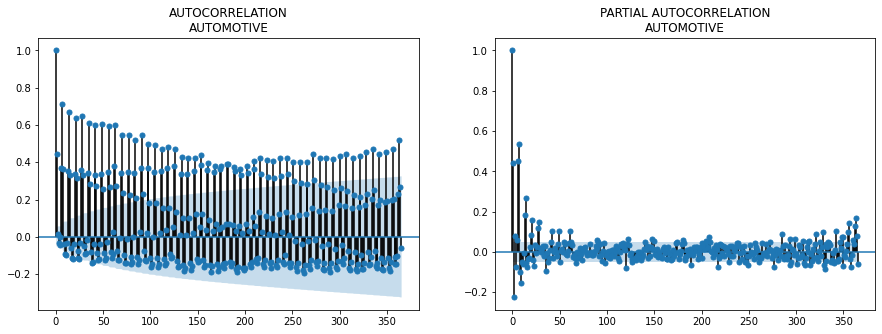

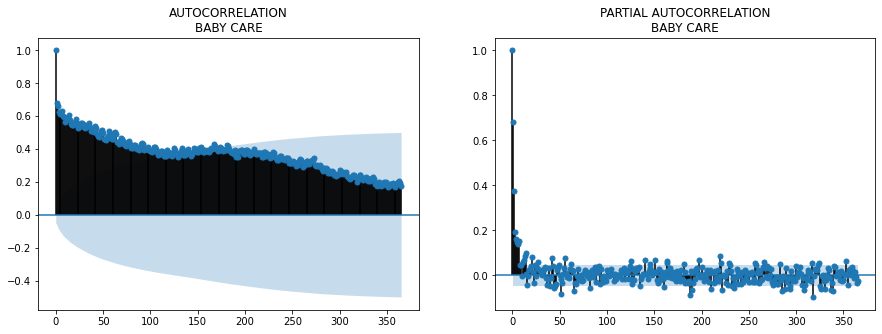

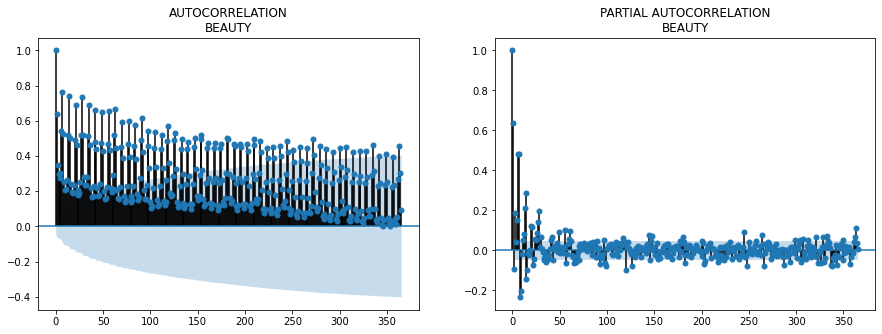

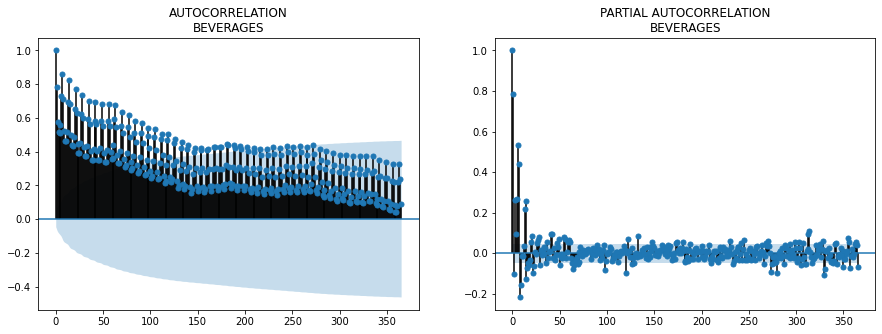

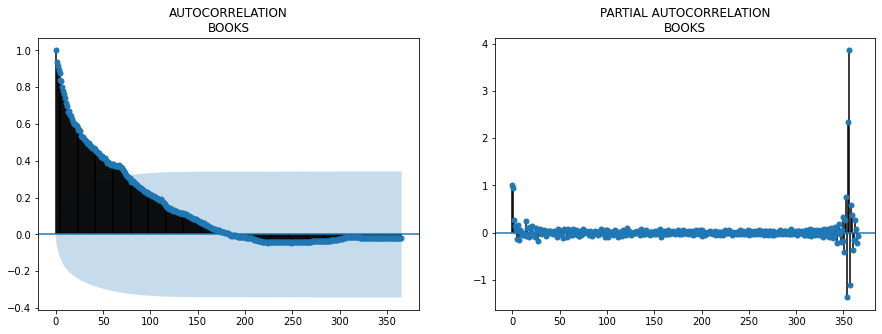

...

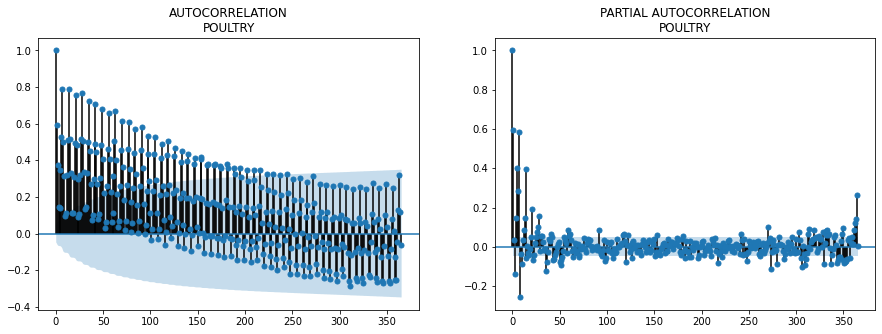

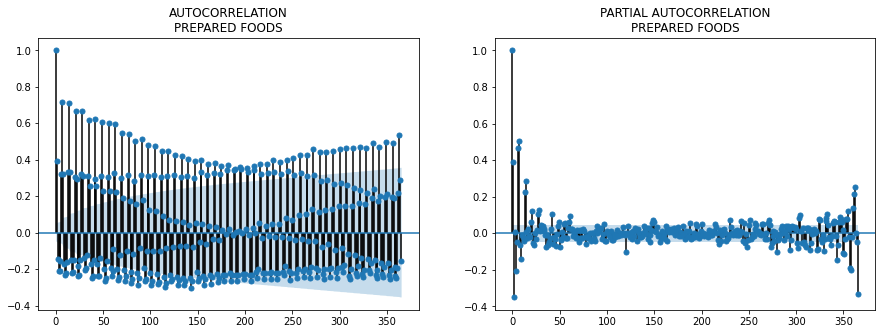

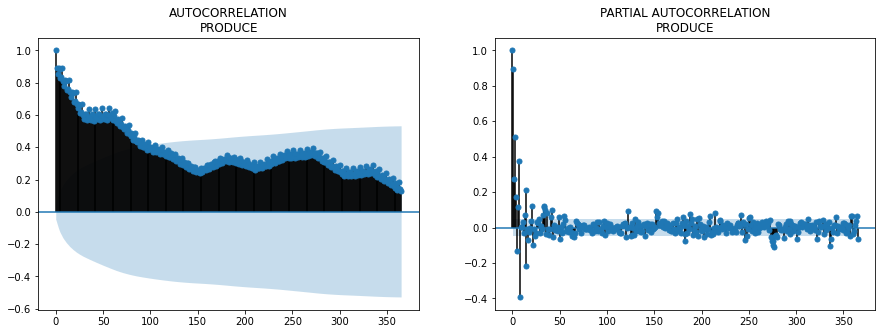

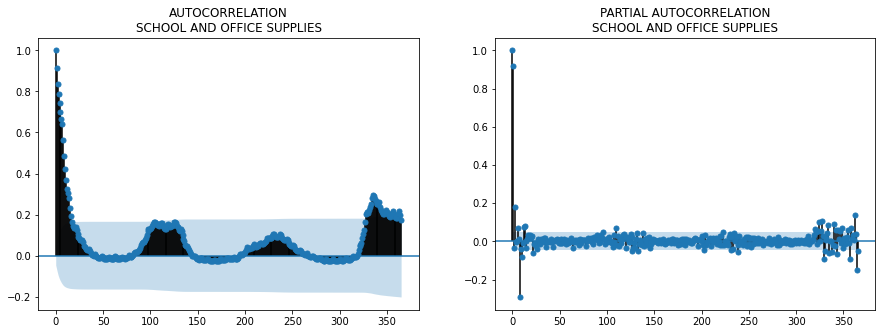

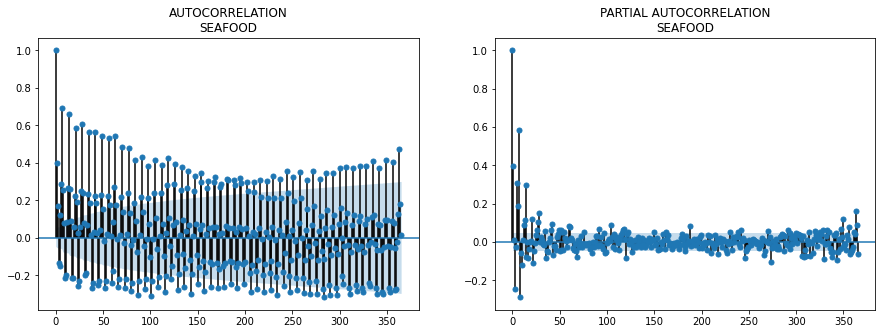

In [101]:
for num, i in enumerate(a.family.unique()):
    try:
      fig, ax = plt.subplots(1, 2, figsize=(15,5))
      temp = a[(a.family == i)]
      sm.graphics.tsa.plot_acf(temp.sales, lags=365, ax=ax[0], title = 'AUTOCORRELATION\n' + i)
      sm.graphics.tsa.plot_pacf(temp.sales, lags=365, ax=ax[1], title='PARTIAL AUTOCORRELATION\n' + i)
    except:
      pass

I decided to chose these lags 16, 20, 30, 45, 365, 730 from PACF. I don't know that they will help me to improve the model but especially, 365th and 730th lags may be helpful. If you compare 2016 and 2017 years for sales, you can see that they are highly correlated.

In [102]:
a = d[d.year.isin([2016, 2017])].groupby(['year','day_of_year']).sales.mean().reset_index()
a.head()

,year,day_of_year,sales
0,2016,1,9.68
1,2016,2,628.20
2,2016,3,722.46
3,2016,4,562.99
4,2016,5,491.94


In [103]:
px.line(a, x = 'day_of_year', y = 'sales', color='year',
        title = 'Average Sales for 2016 and 2017')

## 12. Simple Moving Average

In [104]:
a = train.sort_values(['store_nbr', 'family', 'date'])
for i in [20, 30, 45, 60, 90, 120, 365, 730]:
    a

In [105]:
a = train.sort_values(['store_nbr', 'family', 'date'])
a.groupby(["store_nbr", "family"]).rolling(20).sales.mean().shift(16).values

array([nan, nan, nan, ..., 3.2, 3.1, 2.8])

In [106]:
for i in [20, 30, 45, 60, 90, 120, 365, 730]:
    a['SMA'+str(i)+'_sales_lag16'] = a.groupby(['store_nbr', 'family']).rolling(i).sales.mean().shift(16).values
    a['SMA'+str(i)+'_sales_lag30'] = a.groupby(['store_nbr', 'family']).rolling(i).sales.mean().shift(30).values
    a['SMA'+str(i)+'_sales_lag60'] = a.groupby(['store_nbr', 'family']).rolling(i).sales.mean().shift(60).values


In [107]:
print('Correlation')
a[['sales']+a.columns[a.columns.str.startswith('SMA')].tolist()].corr()

Correlation


,sales,SMA20_sales_lag16,SMA20_sales_lag30,SMA20_sales_lag60,SMA30_sales_lag16,SMA30_sales_lag30,SMA30_sales_lag60,SMA45_sales_lag16,SMA45_sales_lag30,SMA45_sales_lag60,SMA60_sales_lag16,SMA60_sales_lag30,SMA60_sales_lag60,SMA90_sales_lag16,SMA90_sales_lag30,SMA90_sales_lag60,SMA120_sales_lag16,SMA120_sales_lag30,SMA120_sales_lag60,SMA365_sales_lag16,SMA365_sales_lag30,SMA365_sales_lag60,SMA730_sales_lag16,SMA730_sales_lag30,SMA730_sales_lag60
sales,1.00,0.91,0.89,0.87,0.91,0.89,0.87,0.91,0.90,0.87,0.91,0.89,0.87,0.91,0.89,0.87,0.90,0.89,0.86,0.90,0.89,0.87,0.91,0.89,0.86
SMA20_sales_lag16,0.91,1.00,0.99,0.95,1.00,0.98,0.95,0.99,0.98,0.95,0.99,0.98,0.95,0.99,0.98,0.95,0.98,0.97,0.95,0.97,0.97,0.95,0.98,0.98,0.95
SMA20_sales_lag30,0.89,0.99,1.00,0.96,0.99,1.00,0.96,1.00,0.99,0.97,0.99,0.99,0.97,0.99,0.99,0.96,0.99,0.98,0.96,0.97,0.97,0.96,0.98,0.98,0.96
SMA20_sales_lag60,0.87,0.95,0.96,1.00,0.96,0.98,1.00,0.98,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.98,0.98,0.97,0.97,0.98,0.98,0.98
SMA30_sales_lag16,0.91,1.00,0.99,0.96,1.00,0.99,0.96,1.00,0.99,0.96,0.99,0.99,0.96,0.99,0.98,0.96,0.99,0.98,0.96,0.98,0.97,0.96,0.98,0.98,0.96
SMA30_sales_lag30,0.89,0.98,1.00,0.98,0.99,1.00,0.98,1.00,1.00,0.98,1.00,0.99,0.98,0.99,0.99,0.97,0.99,0.99,0.97,0.98,0.98,0.97,0.98,0.98,0.98
SMA30_sales_lag60,0.87,0.95,0.96,1.00,0.96,0.98,1.00,0.98,0.99,1.00,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.98,0.98,0.98,0.98,0.98,0.98
SMA45_sales_lag16,0.91,0.99,1.00,0.98,1.00,1.00,0.98,1.00,1.00,0.98,1.00,0.99,0.98,0.99,0.99,0.98,0.99,0.99,0.97,0.98,0.98,0.97,0.98,0.98,0.98
SMA45_sales_lag30,0.90,0.98,0.99,0.99,0.99,1.00,0.99,1.00,1.00,0.99,1.00,1.00,0.99,1.00,0.99,0.98,0.99,0.99,0.98,0.98,0.98,0.98,0.98,0.98,0.98
SMA45_sales_lag60,0.87,0.95,0.97,0.99,0.96,0.98,1.00,0.98,0.99,1.00,0.99,0.99,1.00,0.99,1.00,0.99,0.99,0.99,0.99,0.98,0.98,0.98,0.98,0.98,0.98


In [108]:
b = a[(a.store_nbr == 1)].set_index('date')
b.head()

,id,store_nbr,family,sales,onpromotion,SMA20_sales_lag16,SMA20_sales_lag30,SMA20_sales_lag60,SMA30_sales_lag16,SMA30_sales_lag30,SMA30_sales_lag60,SMA45_sales_lag16,SMA45_sales_lag30,SMA45_sales_lag60,SMA60_sales_lag16,SMA60_sales_lag30,SMA60_sales_lag60,SMA90_sales_lag16,SMA90_sales_lag30,SMA90_sales_lag60,SMA120_sales_lag16,SMA120_sales_lag30,SMA120_sales_lag60,SMA365_sales_lag16,SMA365_sales_lag30,SMA365_sales_lag60,SMA730_sales_lag16,SMA730_sales_lag30,SMA730_sales_lag60
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2013-01-01,0,1,AUTOMOTIVE,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-02,1782,1,AUTOMOTIVE,2.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-03,3564,1,AUTOMOTIVE,3.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-04,5346,1,AUTOMOTIVE,3.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-05,7128,1,AUTOMOTIVE,5.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [109]:
b.family.unique()

array(['AUTOMOTIVE', 'BEAUTY', 'BEVERAGES', 'BOOKS', 'BREAD/BAKERY',
       'CELEBRATION', 'CLEANING', 'DAIRY', 'DELI', 'EGGS', 'FROZEN FOODS',
       'GROCERY I', 'GROCERY II', 'HARDWARE', 'HOME AND KITCHEN I',
       'HOME AND KITCHEN II', 'HOME APPLIANCES', 'HOME CARE',
       'LADIESWEAR', 'LAWN AND GARDEN', 'LINGERIE', 'LIQUOR,WINE,BEER',
       'MAGAZINES', 'MEATS', 'PERSONAL CARE', 'PET SUPPLIES',
       'PLAYERS AND ELECTRONICS', 'POULTRY', 'PREPARED FOODS', 'PRODUCE',
       'SCHOOL AND OFFICE SUPPLIES', 'SEAFOOD'], dtype=object)

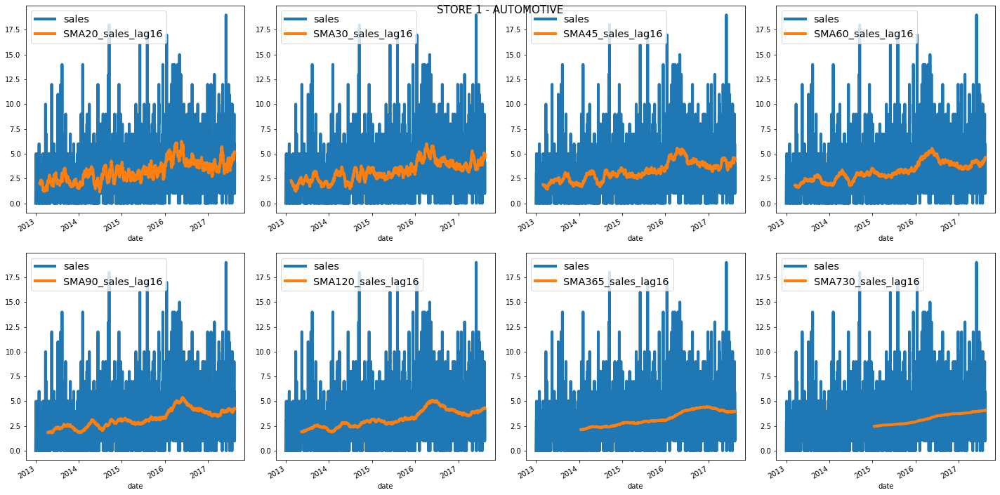

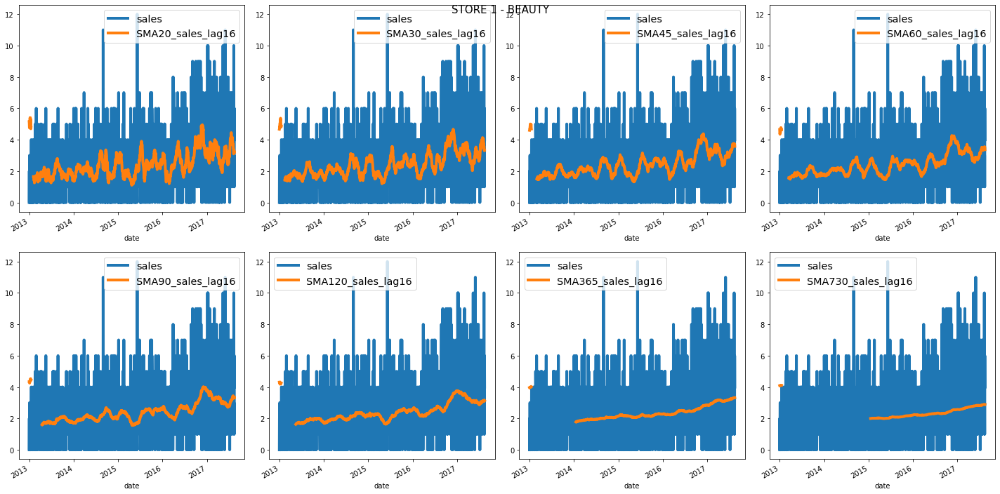

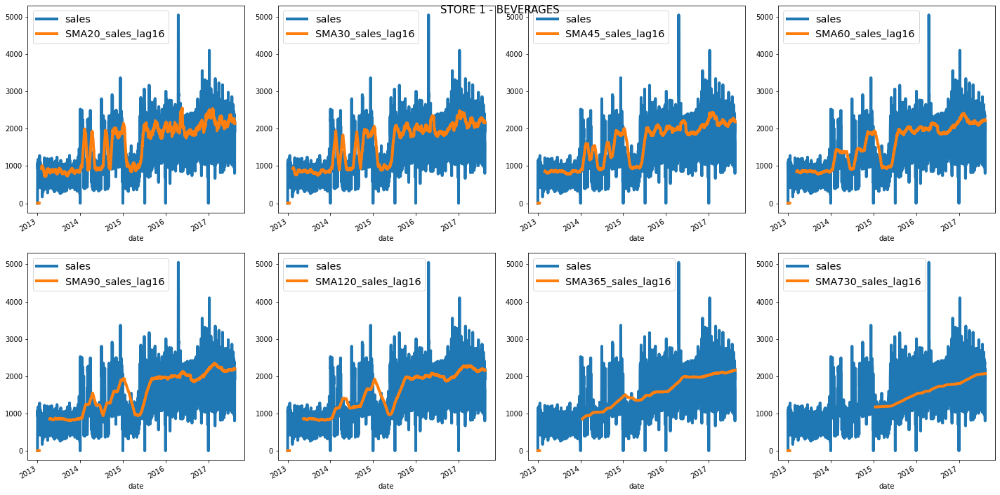

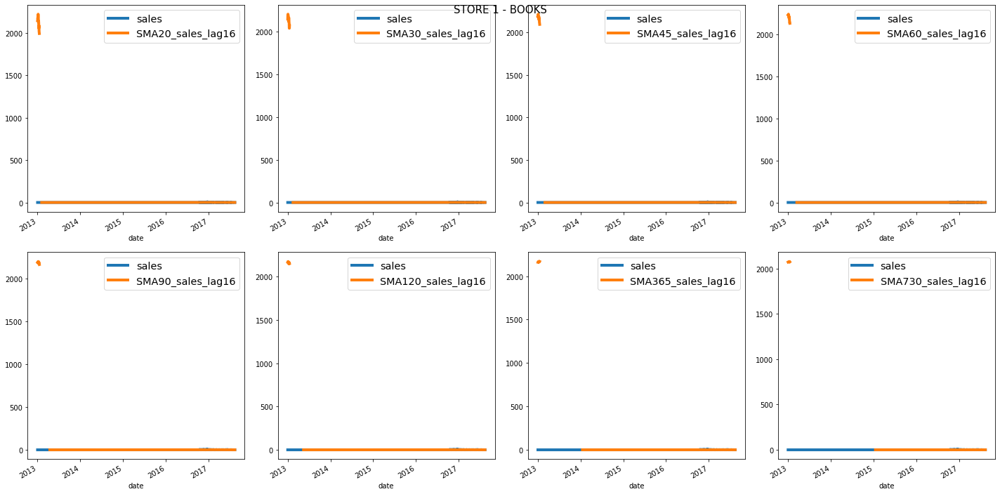

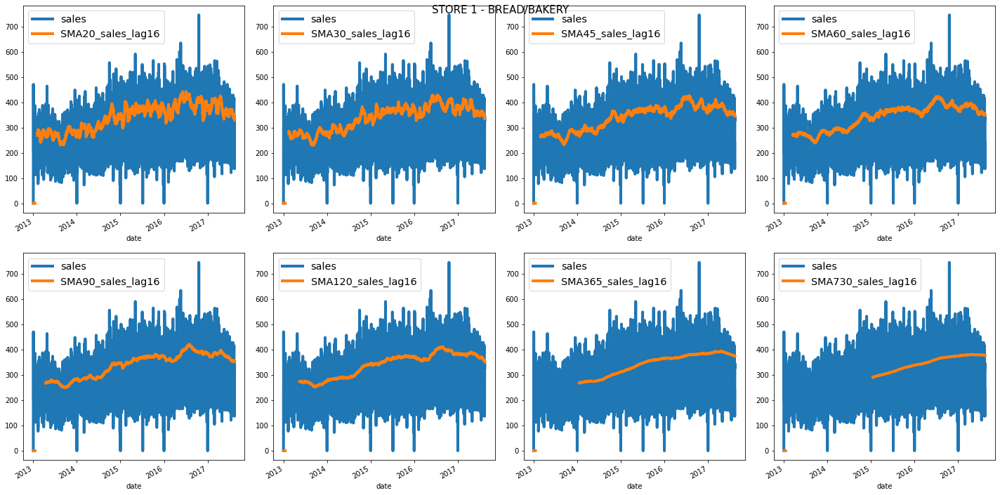

...

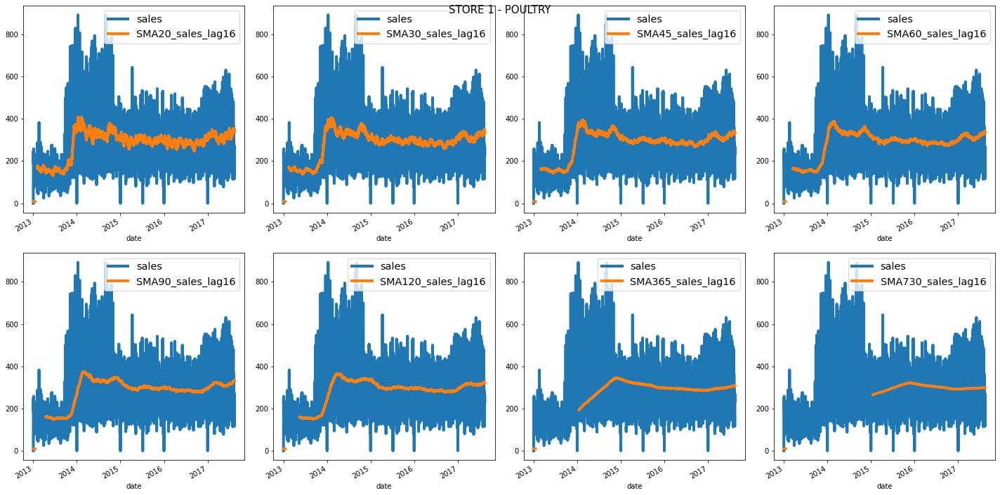

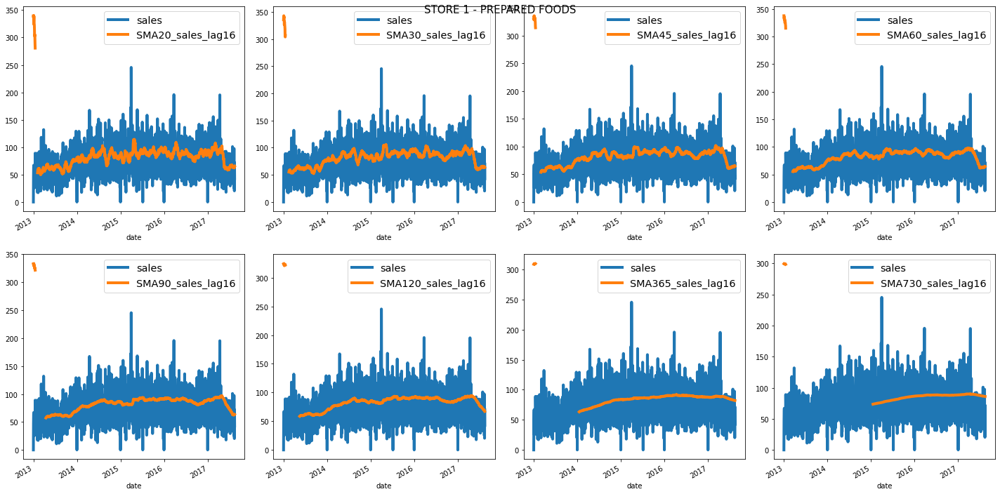

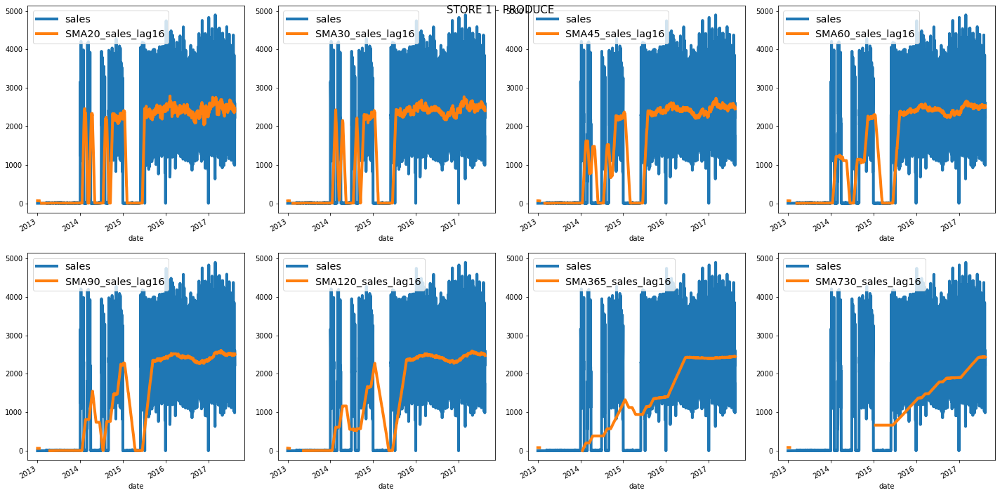

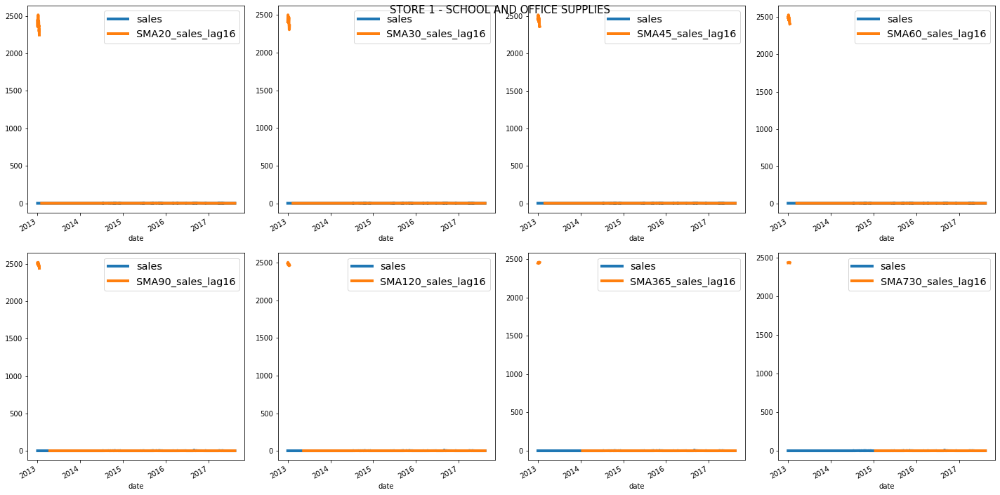

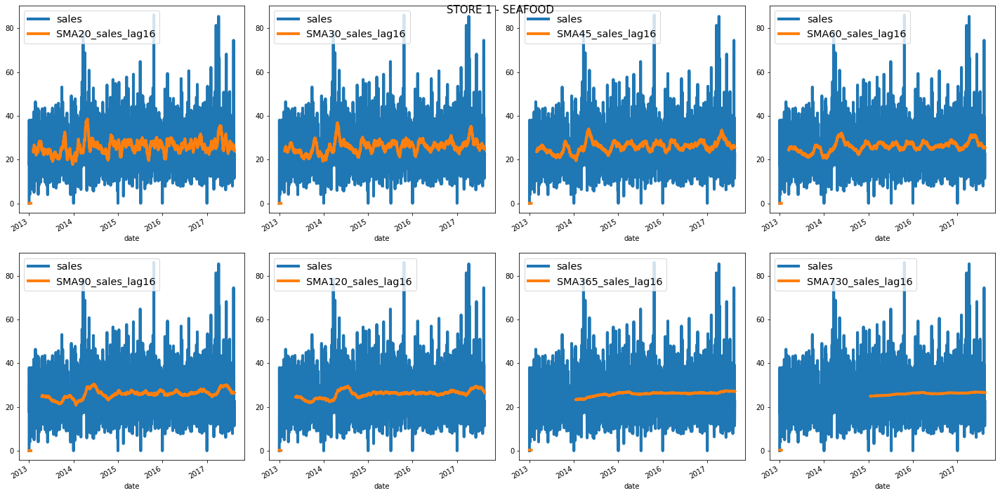

In [112]:
for i in b.family.unique():
    fig, ax = plt.subplots(2, 4, figsize=(20,10))
    b[b.family == i][['sales', 'SMA20_sales_lag16']].plot(legend = True, ax = ax[0,0], linewidth=4)
    b[b.family == i][["sales", "SMA30_sales_lag16"]].plot(legend = True, ax = ax[0,1], linewidth = 4)
    b[b.family == i][["sales", "SMA45_sales_lag16"]].plot(legend = True, ax = ax[0,2], linewidth = 4)
    b[b.family == i][["sales", "SMA60_sales_lag16"]].plot(legend = True, ax = ax[0,3], linewidth = 4)
    b[b.family == i][["sales", "SMA90_sales_lag16"]].plot(legend = True, ax = ax[1,0], linewidth = 4)
    b[b.family == i][["sales", "SMA120_sales_lag16"]].plot(legend = True, ax = ax[1,1], linewidth = 4)
    b[b.family == i][["sales", "SMA365_sales_lag16"]].plot(legend = True, ax = ax[1,2], linewidth = 4)
    b[b.family == i][["sales", "SMA730_sales_lag16"]].plot(legend = True, ax = ax[1,3], linewidth = 4)
    plt.suptitle('STORE 1 - '+i, fontsize=15)
    plt.tight_layout(pad=1.5)
    for j in range(0, 4):
        ax[0,j].legend(fontsize='x-large')
        ax[1,j].legend(fontsize='x-large')
    plt.show()

## 13. Exponential Moving Average

In [126]:
def ewm_features(dataframe, alphas, lags):
    dataframe = dataframe.copy()
    for alpha in alphas:
        for lag in lags:
            dataframe['sales_ewm_alpha_' + str(alpha).replace(".", "") + "_lag_" + str(lag)] = \
                dataframe.groupby(["store_nbr", "family"])['sales']. \
                    transform(lambda x: x.shift(lag).ewm(alpha=alpha).mean())
    return dataframe

In [128]:
alphas = [0.95, 0.9, 0.8, 0.7, 0.5]
lags = [16, 30, 60, 90]

a = ewm_features(a, alphas, lags)

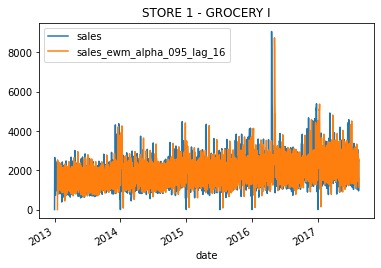

In [129]:
a[(a.store_nbr == 1) & (a.family == "GROCERY I")].set_index("date")[["sales", "sales_ewm_alpha_095_lag_16"]].plot(title = "STORE 1 - GROCERY I");